In [133]:
import scvelo as scv
import pickle
import pandas as pd
import numpy as np
import scanpy as sc

import warnings
warnings.filterwarnings("ignore", "DeprecationWarning")

# Stochastic

In [134]:
with open("../data/merge_velocity.pickle", 'rb') as f:
    merge = pickle.load(f)

In [135]:
cDC1 = merge[merge.obs["Population"].isin(["cDC1"]),]

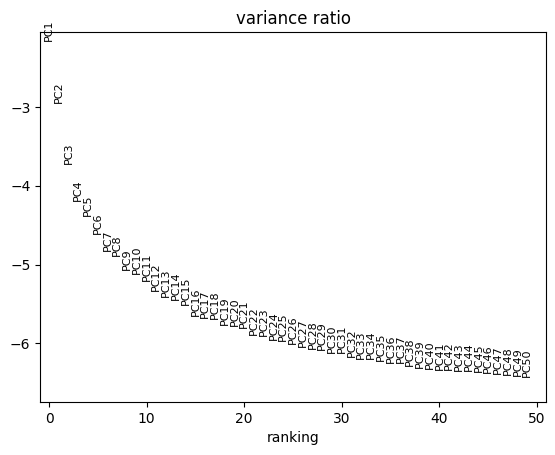

In [136]:
sc.pp.normalize_total(cDC1)
sc.pp.log1p(cDC1)
sc.pp.highly_variable_genes(cDC1)
sc.tl.pca(cDC1)
sc.pl.pca_variance_ratio(cDC1, n_pcs=50, log=True)
sc.pp.neighbors(cDC1, n_pcs = 20)
sc.tl.umap(cDC1)
sc.tl.louvain(cDC1, resolution = 0.5)

In [137]:
scv.pp.filter_and_normalize(cDC1, min_shared_counts=3, n_top_genes=4000)
scv.pp.moments(cDC1)

#scv.tl.umap(DC_merge)

#scv.tl.recover_dynamics(cDC1)
#scv.tl.velocity(cDC1, mode = "dynamical")

scv.tl.velocity(cDC1)
scv.tl.velocity_graph(cDC1)

Filtered out 12878 genes that are detected 3 counts (shared).
Normalized count data: spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.
computing neighbors


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)
    finished (0:00:13) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


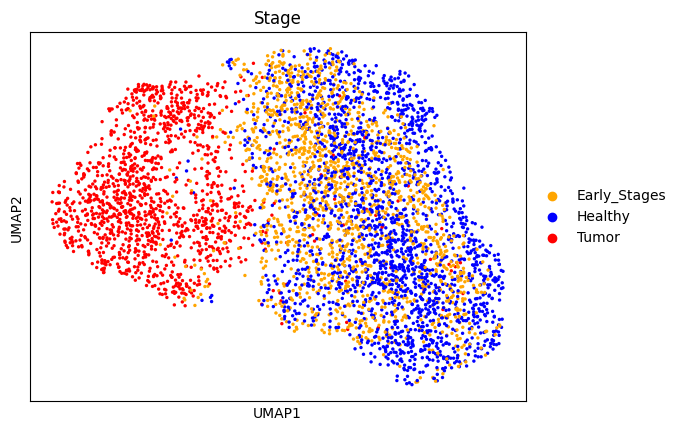

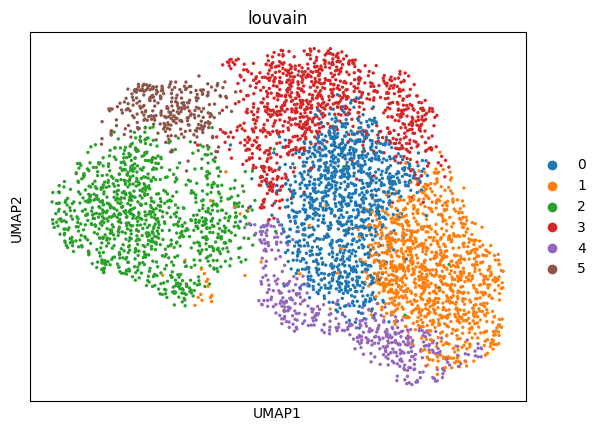

In [138]:
Stage_colors = {"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"}
sc.pl.umap(cDC1, color = 'Stage', palette = Stage_colors)
sc.pl.umap(cDC1, color = 'louvain')

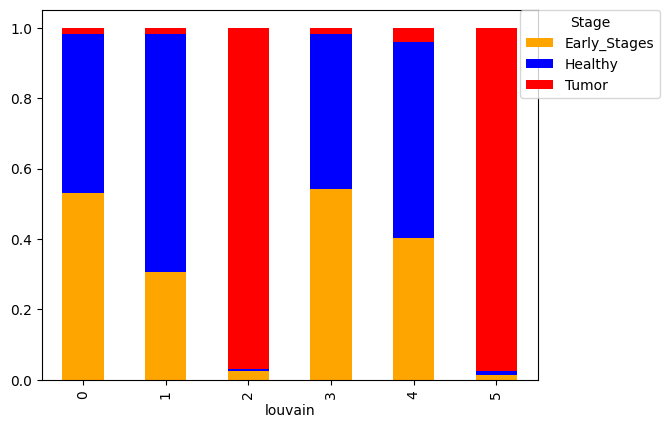

In [139]:
tmp = pd.crosstab(cDC1.obs['Stage'],cDC1.obs['louvain'], normalize='columns').T.plot(kind='bar', stacked=True, color = Stage_colors)
tmp.legend(title='Stage', bbox_to_anchor=(1.26, 1.02),loc='upper right')

On charge la UMAP et le clustering fait sous R pour garder une cohérence.

In [140]:
tab = pd.read_csv("../data/cDC1_metadata.csv", index_col=0)

cDC1.obs["seurat_clusters"] = tab["seurat_clusters"].values
cDC1.obs["seurat_clusters"] = pd.Categorical(cDC1.obs["seurat_clusters"])

cDC1.obs["UMAP_1"] = tab["UMAP_1"].values
cDC1.obs["UMAP_2"] = tab["UMAP_2"].values



cDC1.obsm["X_umap"] = cDC1.obs[["UMAP_1", "UMAP_2"]].values

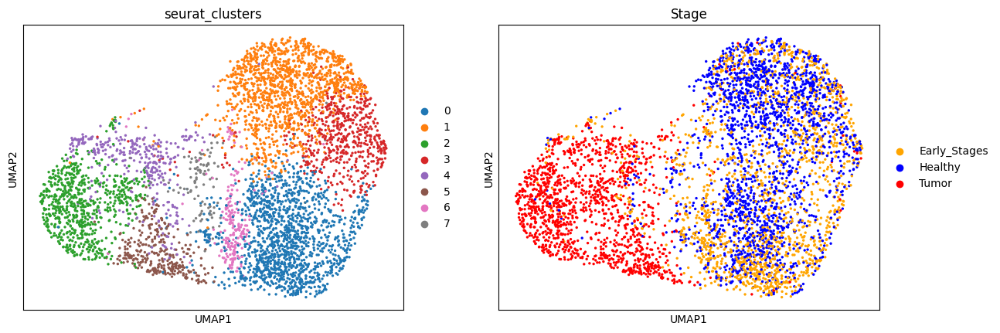

In [141]:
sc.pl.umap(cDC1, color = ["seurat_clusters", "Stage"])

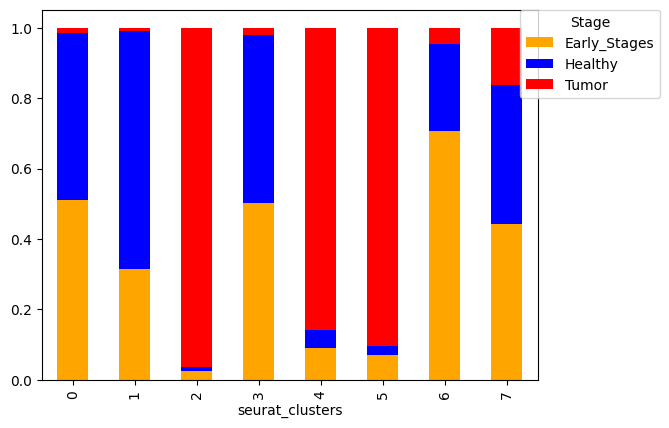

In [142]:
tmp = pd.crosstab(cDC1.obs['Stage'],cDC1.obs['seurat_clusters'], normalize='columns').T.plot(kind='bar', stacked=True, color = Stage_colors)
tmp.legend(title='Stage', bbox_to_anchor=(1.26, 1.02),loc='upper right')

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

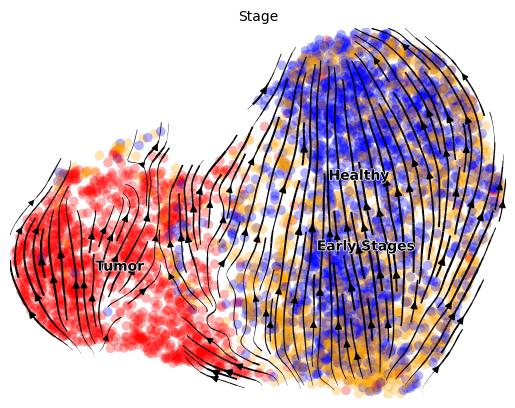

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

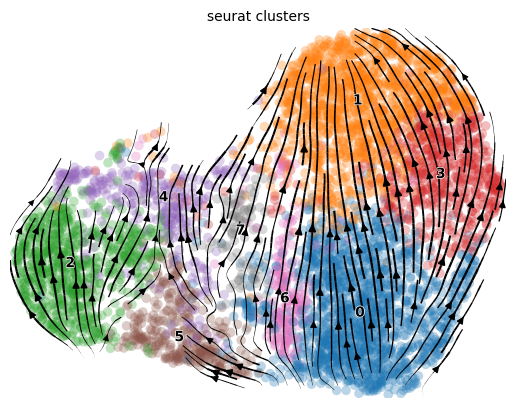

In [143]:
scv.pl.velocity_embedding_stream(cDC1, basis='umap', color = "Stage")
scv.pl.velocity_embedding_stream(cDC1, basis='umap', color = "seurat_clusters")

In [144]:
sc.tl.diffmap(cDC1)
cDC1.obsm["X_diffmap_2D"] = cDC1.obsm["X_diffmap"][:,1:]

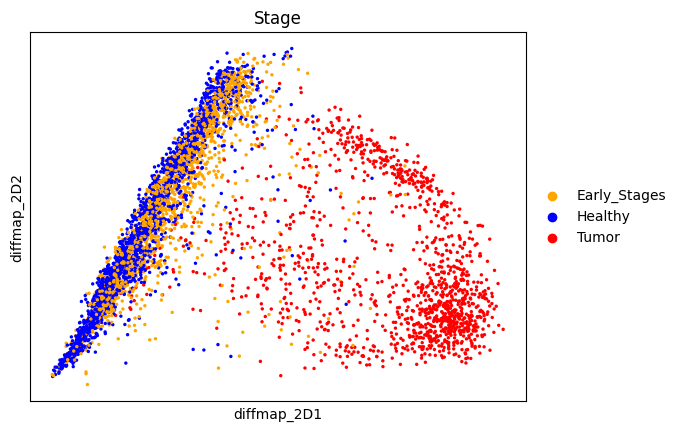

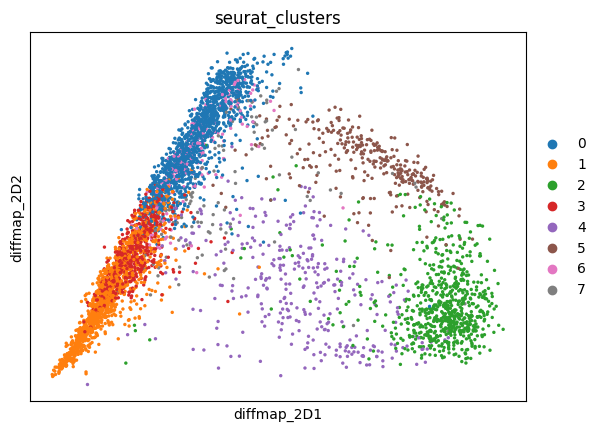

In [145]:
sc.pl.embedding(cDC1, color = 'Stage', basis = "diffmap_2D")
sc.pl.embedding(cDC1, color = 'seurat_clusters', basis = "diffmap_2D")

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

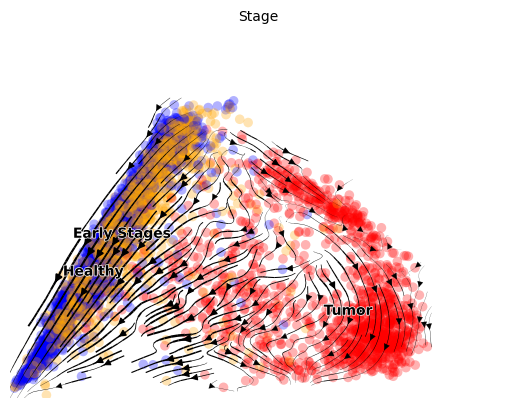

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

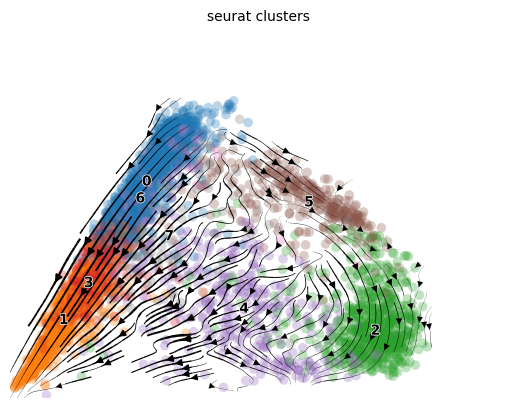

In [146]:
scv.pl.velocity_embedding_stream(cDC1, basis='diffmap', color = "Stage")
scv.pl.velocity_embedding_stream(cDC1, basis='diffmap', color = "seurat_clusters")

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

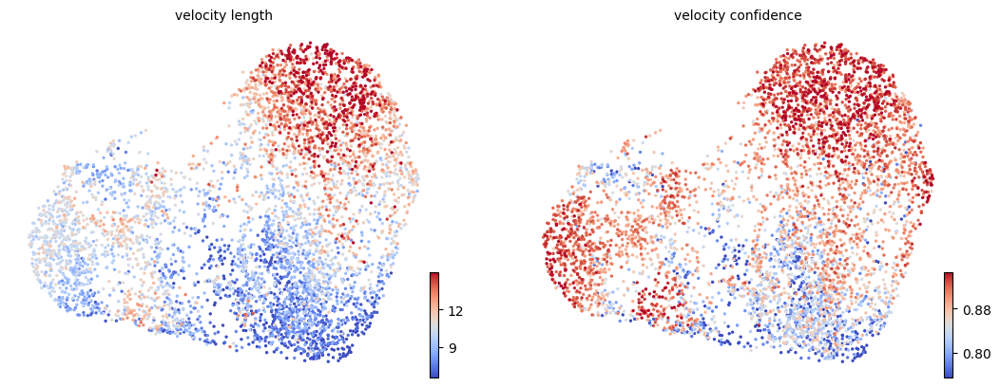

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

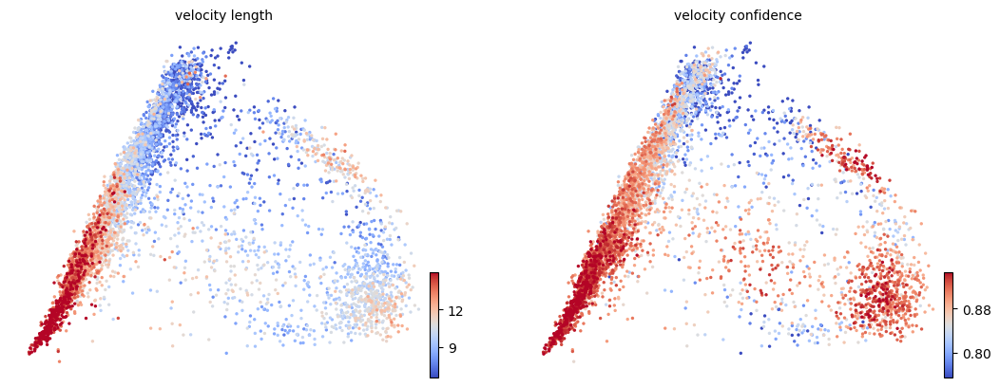

In [147]:
scv.tl.velocity_confidence(cDC1)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(cDC1, c=keys, cmap='coolwarm', perc=[5, 95])
scv.pl.scatter(cDC1, c=keys, cmap='coolwarm', perc=[5, 95], basis = "diffmap")

In [148]:
import cytopath

In [149]:
scv.tl.terminal_states(cDC1, random_state=123)
cDC1.uns["T_forward"] = scv.utils.get_transition_matrix(cDC1, self_transitions=False)
scv.tl.velocity_embedding(cDC1)

computing terminal states
    identified 3 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

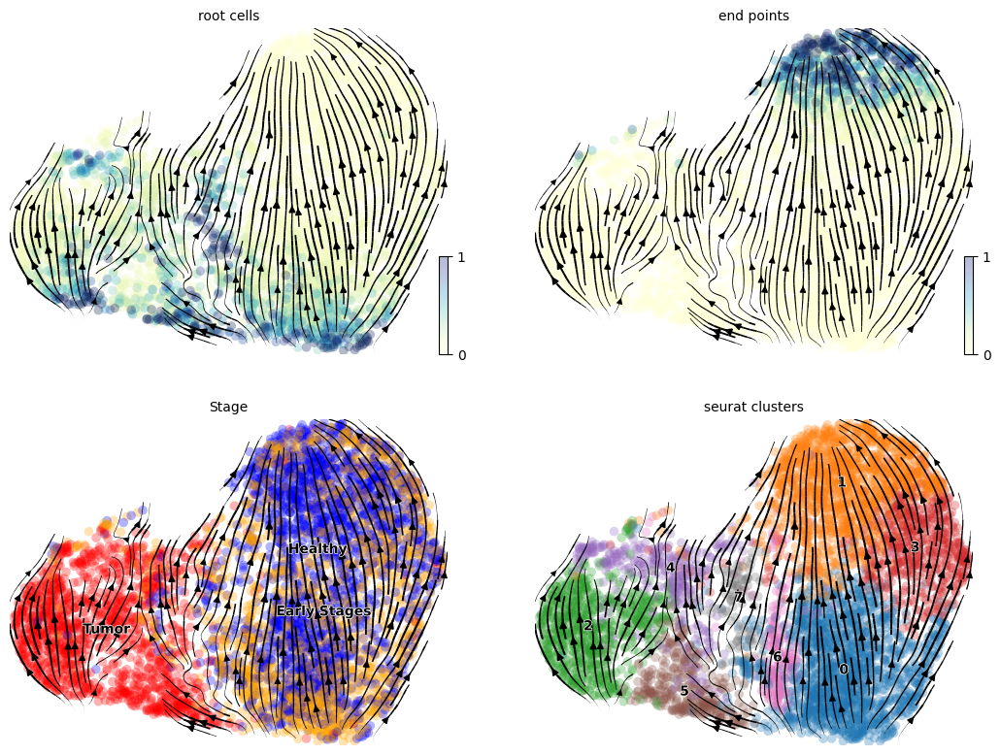

In [150]:
scv.pl.velocity_embedding_stream(cDC1, color=['root_cells', 'end_points',
                                               'Stage', "seurat_clusters"],
                                             ncols=2, color_map='YlGnBu')

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

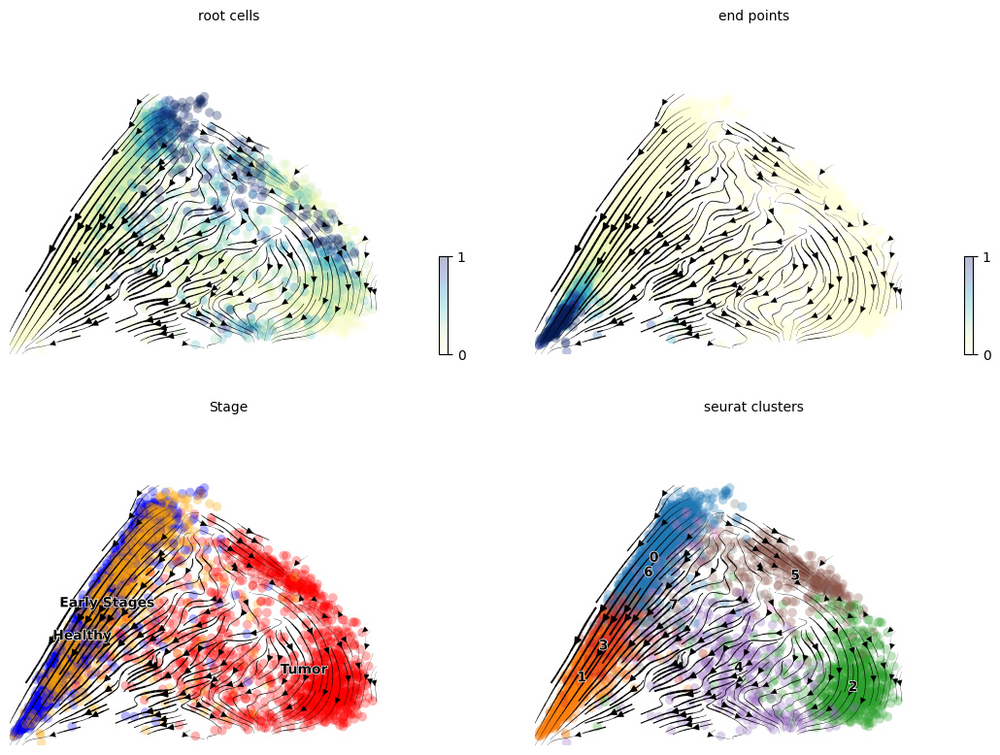

In [151]:
scv.pl.velocity_embedding_stream(cDC1, color=['root_cells', 'end_points',
                                               'Stage', "seurat_clusters"],
                                             ncols=2, color_map='YlGnBu', basis="diffmap")

In [152]:
import os

cDC1.obs["seurat_clusters"] = [str(i) for i in tab["seurat_clusters"].values]
cDC1.obs["seurat_clusters"] = pd.Categorical(cDC1.obs["seurat_clusters"])

cytopath.sampling(cDC1, cluster_key="seurat_clusters", num_cores=os.cpu_count()-1, max_iter = 800, max_steps=100)
#infer trajectories

Adjusting simulation parameters based on dataset properties. Set auto_adjust=False if this is unwanted.
Number of required simulations per end point (traj_number) set to 740
Number of initial simulations (sim_number) set to 4959


Iterating state probability distributions: 100%|██████████| 800/800 [00:03<00:00, 258.43it/s]


Tolerance reached after 19 iterations of 800.
Number of initial simulation steps (max_steps) set to 19

Sampling round: 0


100%|██████████| 103/103 [00:11<00:00,  9.00it/s]


Sampling done.


In [153]:
cytopath.trajectories(cDC1, num_cores=os.cpu_count()-1, basis = "diffmap_2D")

Calculating hausdorff distances


100%|██████████| 740/740 [00:09<00:00, 78.29it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:03<00:00,  1.66s/it]


Sample clustering done. Aligning clusters for end point 1
Computing neighborhoods of trajectories for end point 1 at each step


100%|██████████| 2/2 [00:00<00:00,  2.58it/s]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  1


100%|██████████| 113/113 [00:10<00:00, 11.09it/s]


Removing cells below cutoff threshold from trajectories for end point  1 (i.e. cells neighborhood)


100%|██████████| 2/2 [00:00<00:00, 117.21it/s]


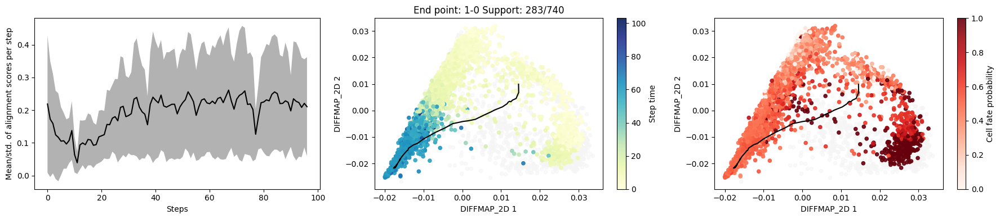

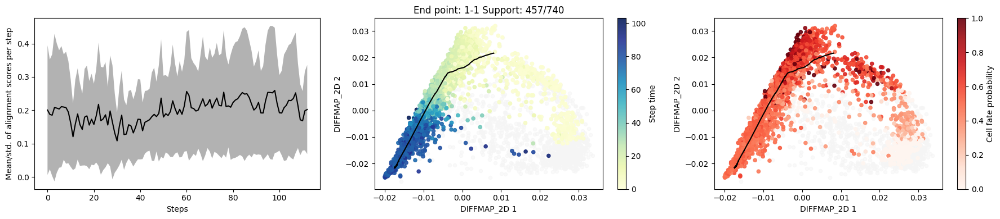

In [154]:
# Plot allignment and trajectories
cytopath.plot_trajectories(cDC1, directory='', basis='diffmap_2D', smoothing=False, size=20, figsize=(18,4))

# Deterministic

In [155]:
with open("../data/merge_velocity.pickle", 'rb') as f:
    merge = pickle.load(f)

In [156]:
cDC1 = merge[merge.obs["Population"].isin(["cDC1"]),]

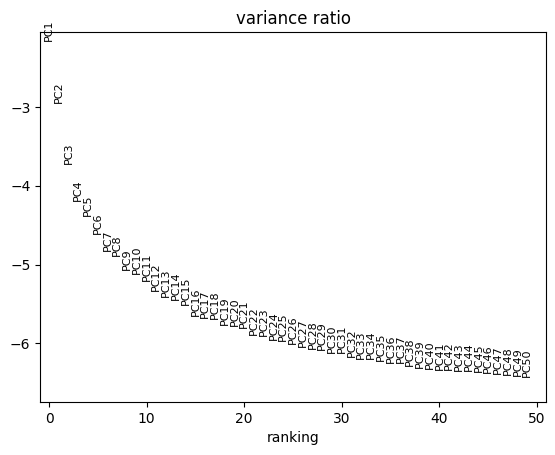

In [157]:
sc.pp.normalize_total(cDC1)
sc.pp.log1p(cDC1)
sc.pp.highly_variable_genes(cDC1)
sc.tl.pca(cDC1)
sc.pl.pca_variance_ratio(cDC1, n_pcs=50, log=True)
sc.pp.neighbors(cDC1, n_pcs = 20)
sc.tl.umap(cDC1)
sc.tl.louvain(cDC1, resolution = 0.5)

In [158]:
scv.pp.filter_and_normalize(cDC1, min_shared_counts=3, n_top_genes=4000)
scv.pp.moments(cDC1)

#scv.tl.umap(DC_merge)

#scv.tl.recover_dynamics(cDC1)
#scv.tl.velocity(cDC1, mode = "dynamical")

scv.tl.velocity(cDC1, mode = 'deterministic')
scv.tl.velocity_graph(cDC1)


Filtered out 12878 genes that are detected 3 counts (shared).
Normalized count data: spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.
computing neighbors


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)
    finished (0:00:07) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


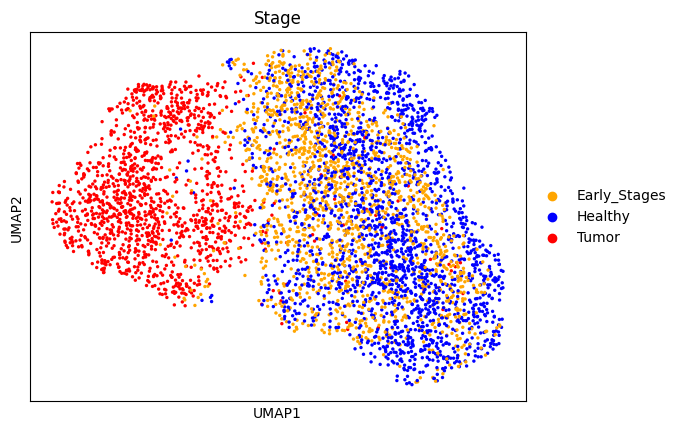

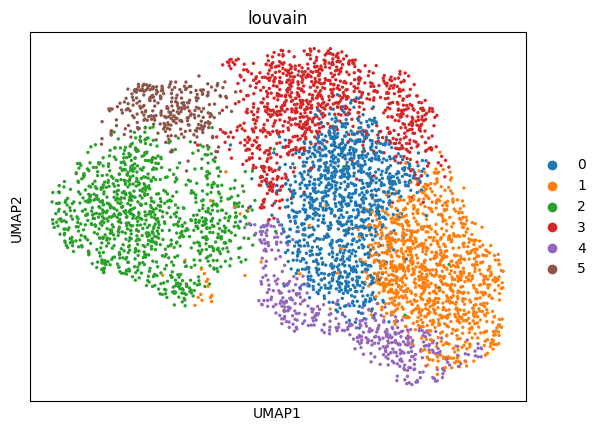

In [159]:
Stage_colors = {"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"}
sc.pl.umap(cDC1, color = 'Stage', palette = Stage_colors)
sc.pl.umap(cDC1, color = 'louvain')

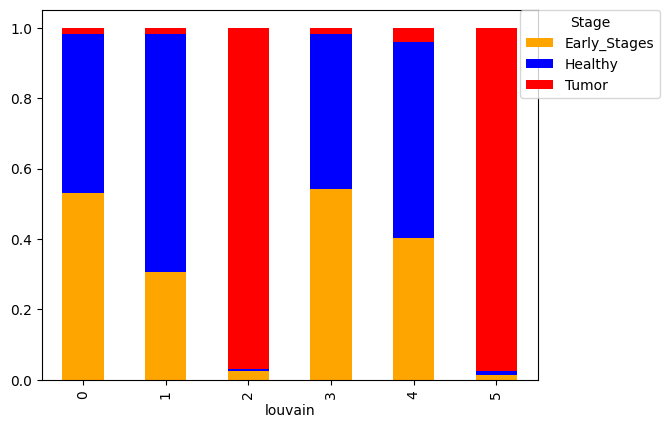

In [160]:
tmp = pd.crosstab(cDC1.obs['Stage'],cDC1.obs['louvain'], normalize='columns').T.plot(kind='bar', stacked=True, color = Stage_colors)
tmp.legend(title='Stage', bbox_to_anchor=(1.26, 1.02),loc='upper right')

On charge la UMAP et le clustering fait sous R pour garder une cohérence.

In [161]:
tab = pd.read_csv("../data/cDC1_metadata.csv", index_col=0)

cDC1.obs["seurat_clusters"] = tab["seurat_clusters"].values
cDC1.obs["seurat_clusters"] = pd.Categorical(cDC1.obs["seurat_clusters"])

cDC1.obs["UMAP_1"] = tab["UMAP_1"].values
cDC1.obs["UMAP_2"] = tab["UMAP_2"].values



cDC1.obsm["X_umap"] = cDC1.obs[["UMAP_1", "UMAP_2"]].values

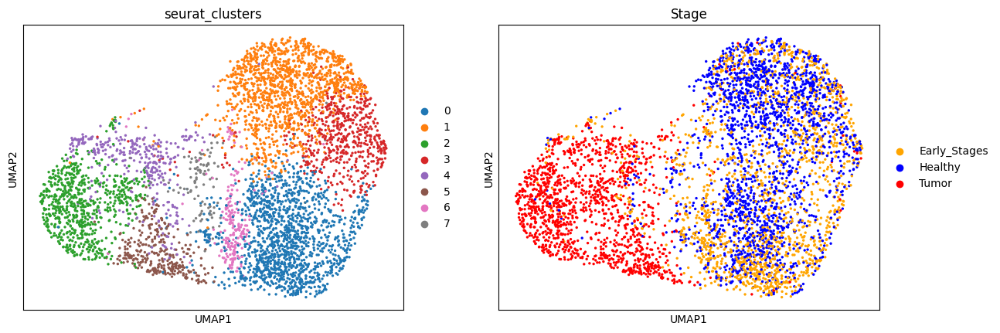

In [162]:
sc.pl.umap(cDC1, color = ["seurat_clusters", "Stage"])

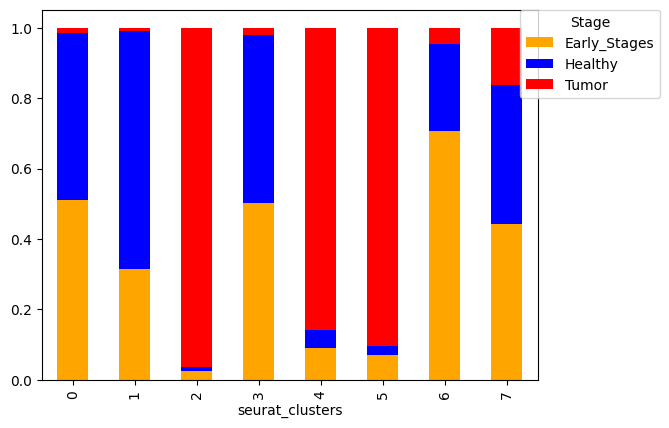

In [163]:
tmp = pd.crosstab(cDC1.obs['Stage'],cDC1.obs['seurat_clusters'], normalize='columns').T.plot(kind='bar', stacked=True, color = Stage_colors)
tmp.legend(title='Stage', bbox_to_anchor=(1.26, 1.02),loc='upper right')

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

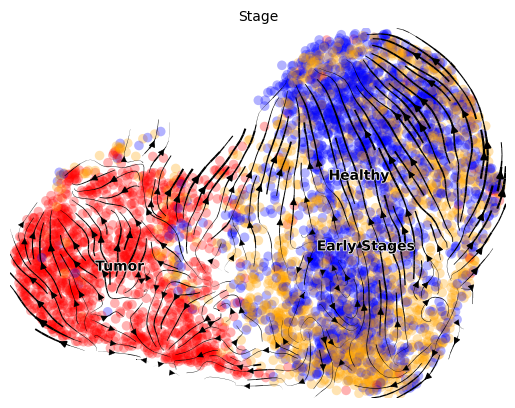

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

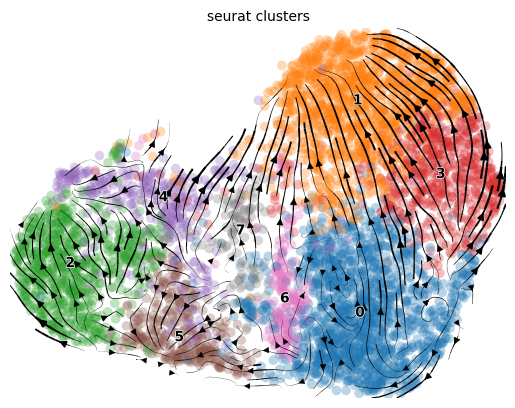

In [164]:
scv.pl.velocity_embedding_stream(cDC1, basis='umap', color = "Stage")
scv.pl.velocity_embedding_stream(cDC1, basis='umap', color = "seurat_clusters")

In [165]:
sc.tl.diffmap(cDC1, n_comps = 20)
cDC1.obsm["X_diffmap_2D"] = cDC1.obsm["X_diffmap"][:,1:]

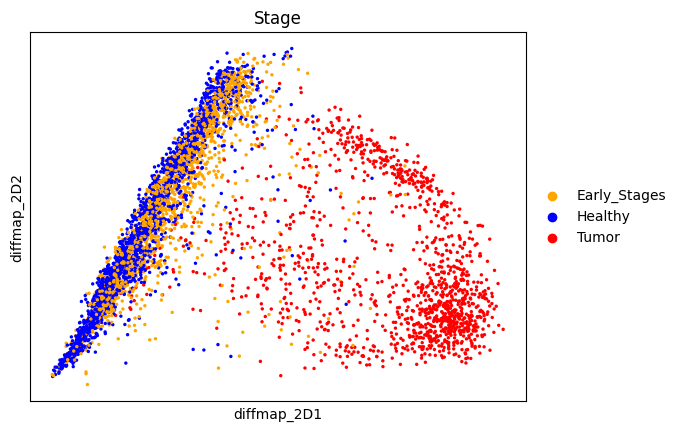

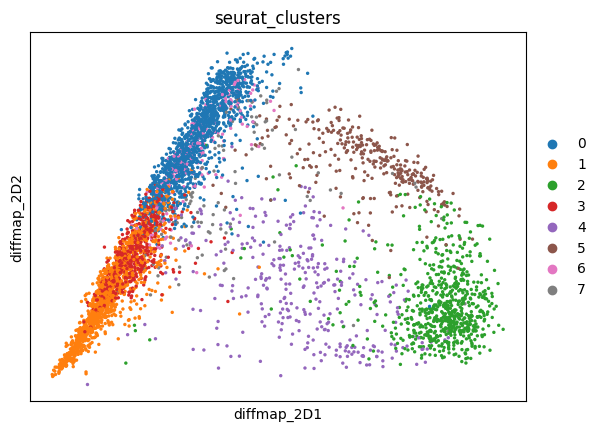

In [166]:
sc.pl.embedding(cDC1, color = 'Stage', basis = "diffmap_2D")
sc.pl.embedding(cDC1, color = 'seurat_clusters', basis = "diffmap_2D")

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

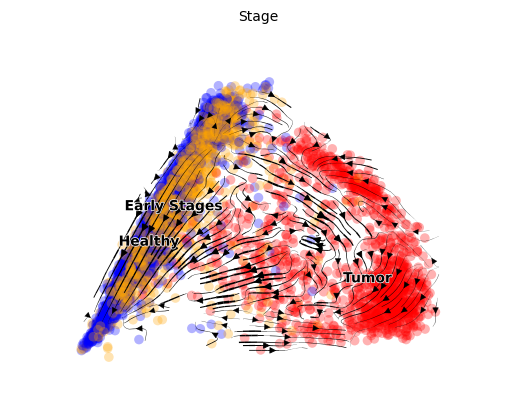

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

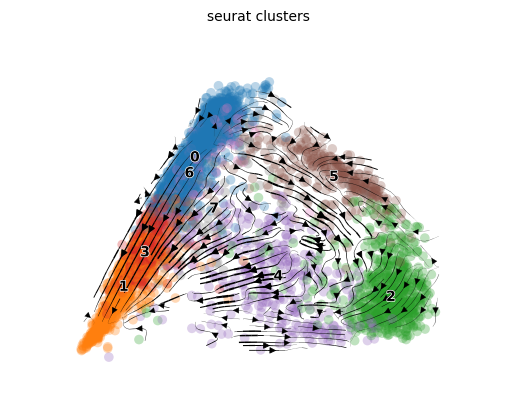

In [167]:
scv.pl.velocity_embedding_stream(cDC1, basis='diffmap', color = "Stage")
scv.pl.velocity_embedding_stream(cDC1, basis='diffmap', color = "seurat_clusters")

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

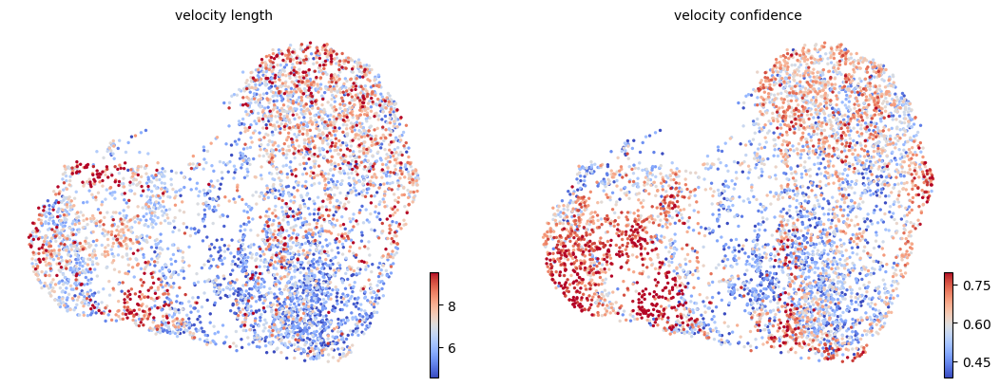

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

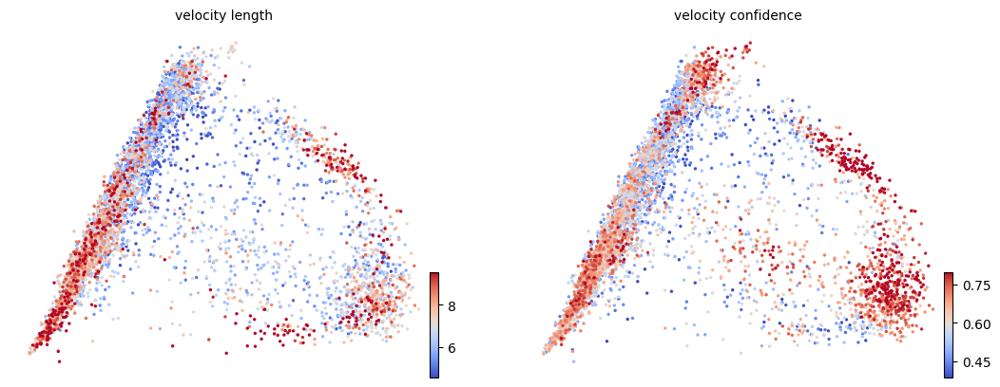

In [168]:
scv.tl.velocity_confidence(cDC1)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(cDC1, c=keys, cmap='coolwarm', perc=[5, 95])
scv.pl.scatter(cDC1, c=keys, cmap='coolwarm', perc=[5, 95], basis = "diffmap")

In [169]:
import cytopath

In [170]:
scv.tl.terminal_states(cDC1, random_state=123)
cDC1.uns["T_forward"] = scv.utils.get_transition_matrix(cDC1, self_transitions=False)
scv.tl.velocity_embedding(cDC1)

computing terminal states
    identified 3 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

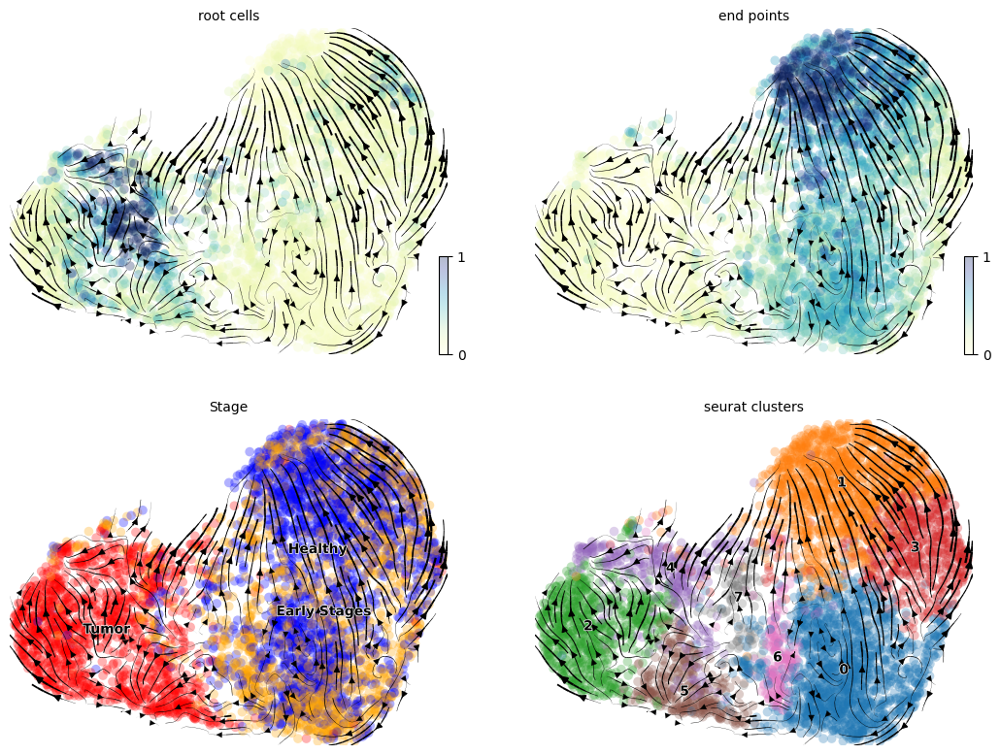

In [171]:
scv.pl.velocity_embedding_stream(cDC1, color=['root_cells', 'end_points',
                                               'Stage', "seurat_clusters"],
                                             ncols=2, color_map='YlGnBu')

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

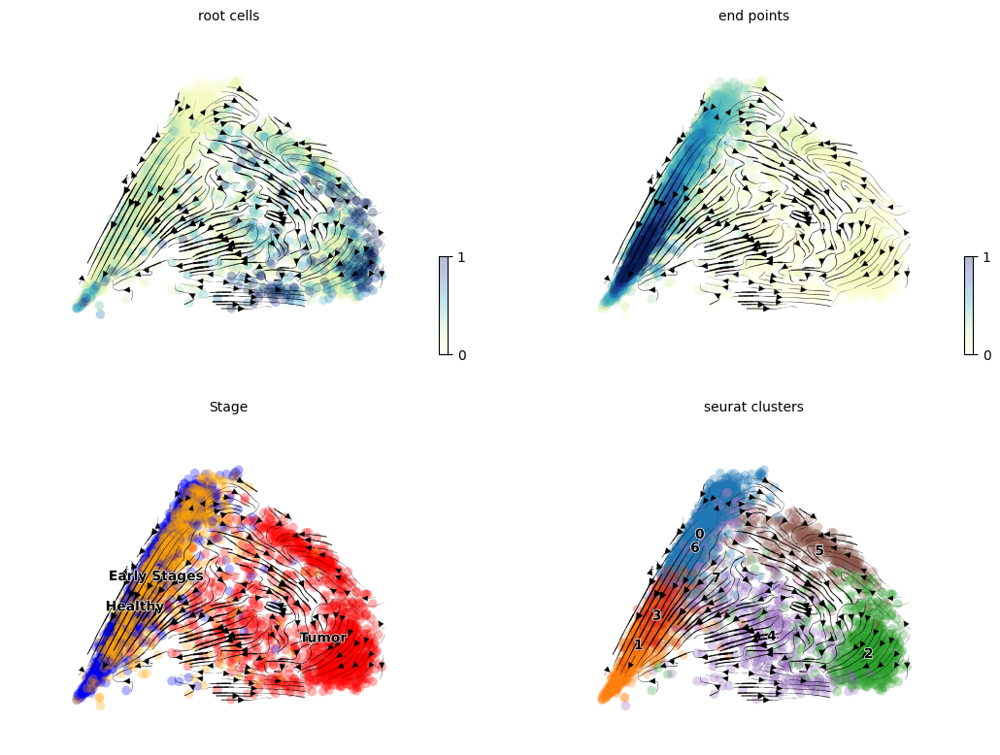

In [172]:
scv.pl.velocity_embedding_stream(cDC1, color=['root_cells', 'end_points',
                                               'Stage', "seurat_clusters"],
                                             ncols=2, color_map='YlGnBu', basis="diffmap")

In [173]:
import os

cDC1.obs["seurat_clusters"] = [str(i) for i in tab["seurat_clusters"].values]
cDC1.obs["seurat_clusters"] = pd.Categorical(cDC1.obs["seurat_clusters"])

cytopath.sampling(cDC1, cluster_key="seurat_clusters", num_cores=os.cpu_count()-1, max_iter = 800, max_steps=100)
#infer trajectories

Adjusting simulation parameters based on dataset properties. Set auto_adjust=False if this is unwanted.
Number of required simulations per end point (traj_number) set to 740
Number of initial simulations (sim_number) set to 4969


Iterating state probability distributions: 100%|██████████| 800/800 [00:03<00:00, 260.48it/s]


Tolerance reached after 31 iterations of 800.
Number of initial simulation steps (max_steps) set to 31

Sampling round: 0


100%|██████████| 104/104 [00:00<00:00, 141.41it/s]


Sampling done.


In [174]:
cytopath.trajectories(cDC1, num_cores=os.cpu_count()-1, basis = "diffmap_2D")

Calculating hausdorff distances


100%|██████████| 740/740 [00:09<00:00, 80.40it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:04<00:00,  2.29s/it]


Sample clustering done. Aligning clusters for end point 1
Computing neighborhoods of trajectories for end point 1 at each step


100%|██████████| 1/1 [00:00<00:00,  3.53it/s]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  1


100%|██████████| 78/78 [00:05<00:00, 15.01it/s]


Removing cells below cutoff threshold from trajectories for end point  1 (i.e. cells neighborhood)


100%|██████████| 1/1 [00:00<00:00, 225.17it/s]


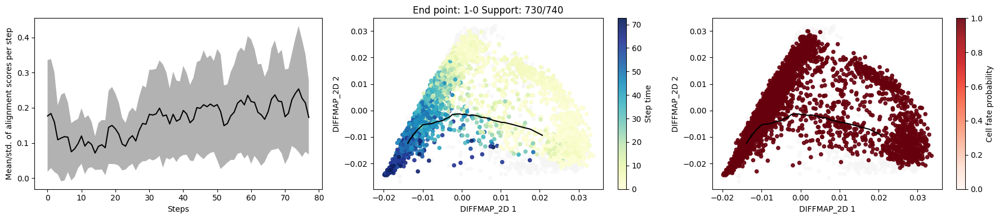

In [175]:
# Plot allignment and trajectories
cytopath.plot_trajectories(cDC1, directory='', basis='diffmap_2D', smoothing=False, size=20, figsize=(18,4))

# Dynamical

In [31]:
with open("../data/merge_velocity.pickle", 'rb') as f:
    merge = pickle.load(f)

In [32]:
cDC1 = merge[merge.obs["Population"].isin(["cDC1"]),]

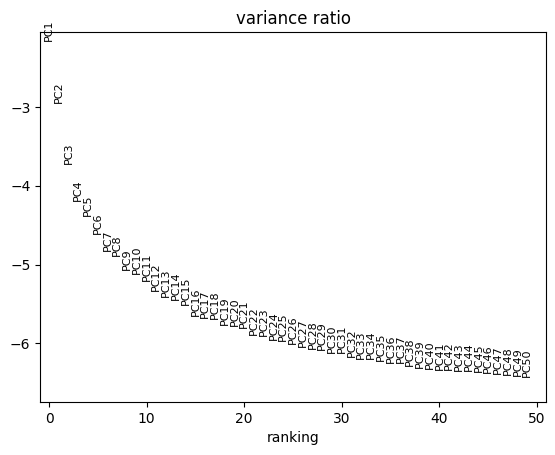

In [33]:
sc.pp.normalize_total(cDC1)
sc.pp.log1p(cDC1)
sc.pp.highly_variable_genes(cDC1)
sc.tl.pca(cDC1)
sc.pl.pca_variance_ratio(cDC1, n_pcs=50, log=True)
sc.pp.neighbors(cDC1, n_pcs = 20)
sc.tl.umap(cDC1)
sc.tl.louvain(cDC1, resolution = 0.5)

In [34]:
scv.pp.filter_and_normalize(cDC1, min_shared_counts=3, n_top_genes=4000)
scv.pp.moments(cDC1)

#scv.tl.umap(DC_merge)

scv.tl.recover_dynamics(cDC1)
scv.tl.velocity(cDC1, mode = "dynamical")

#scv.tl.velocity(cDC1)
scv.tl.velocity_graph(cDC1)


Filtered out 12878 genes that are detected 3 counts (shared).
Normalized count data: spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.
computing neighbors


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 1/12 cores)
    finished (0:04:12) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)
    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


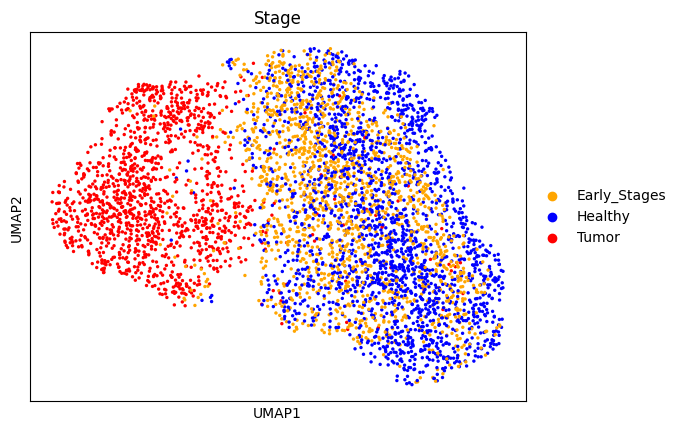

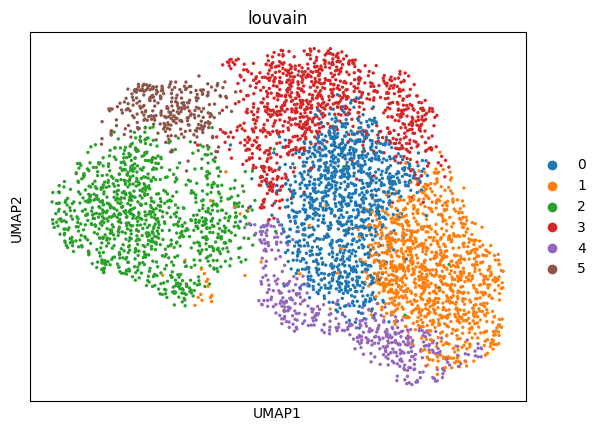

In [35]:
Stage_colors = {"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"}
sc.pl.umap(cDC1, color = 'Stage', palette = Stage_colors)
sc.pl.umap(cDC1, color = 'louvain')

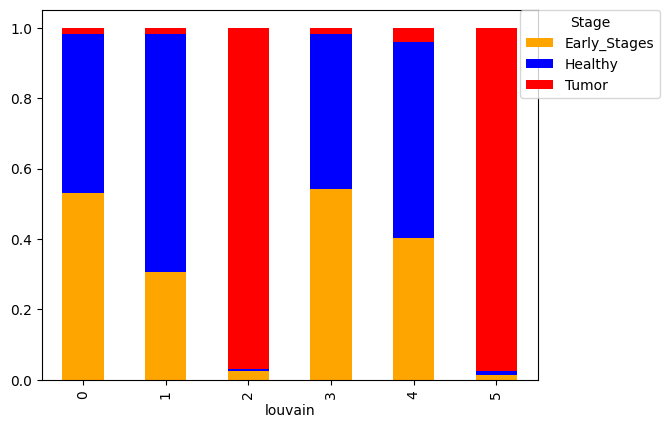

In [36]:
tmp = pd.crosstab(cDC1.obs['Stage'],cDC1.obs['louvain'], normalize='columns').T.plot(kind='bar', stacked=True, color = Stage_colors)
tmp.legend(title='Stage', bbox_to_anchor=(1.26, 1.02),loc='upper right')

On charge la UMAP et le clustering fait sous R pour garder une cohérence.

In [37]:
tab = pd.read_csv("../data/cDC1_metadata.csv", index_col=0)

cDC1.obs["seurat_clusters"] = tab["seurat_clusters"].values
cDC1.obs["seurat_clusters"] = pd.Categorical(cDC1.obs["seurat_clusters"])

cDC1.obs["UMAP_1"] = tab["UMAP_1"].values
cDC1.obs["UMAP_2"] = tab["UMAP_2"].values



cDC1.obsm["X_umap"] = cDC1.obs[["UMAP_1", "UMAP_2"]].values

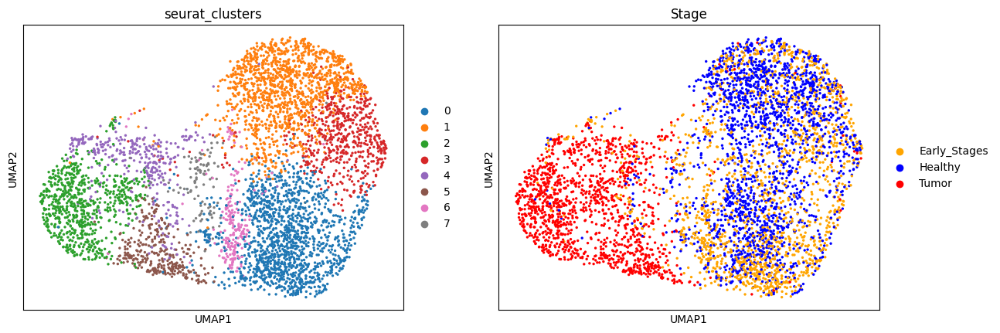

In [38]:
sc.pl.umap(cDC1, color = ["seurat_clusters", "Stage"])

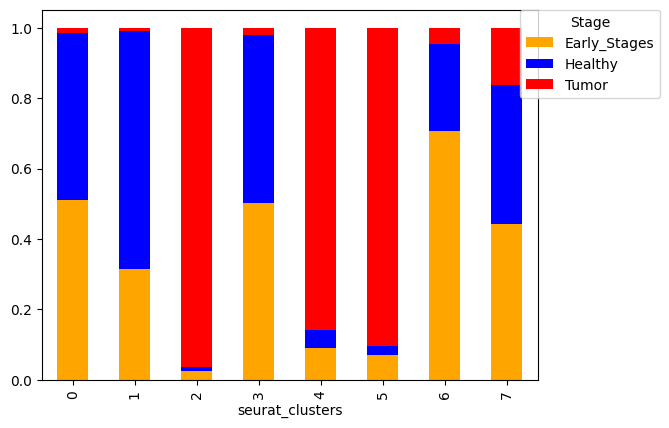

In [39]:
tmp = pd.crosstab(cDC1.obs['Stage'],cDC1.obs['seurat_clusters'], normalize='columns').T.plot(kind='bar', stacked=True, color = Stage_colors)
tmp.legend(title='Stage', bbox_to_anchor=(1.26, 1.02),loc='upper right')

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

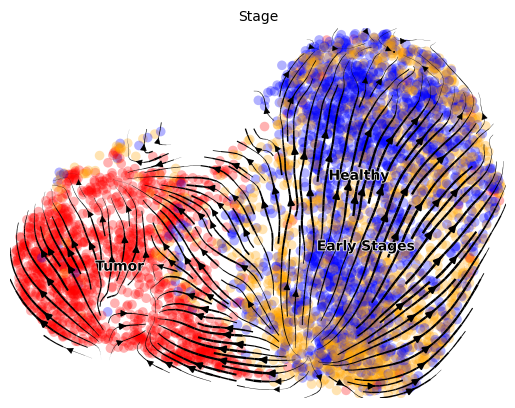

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

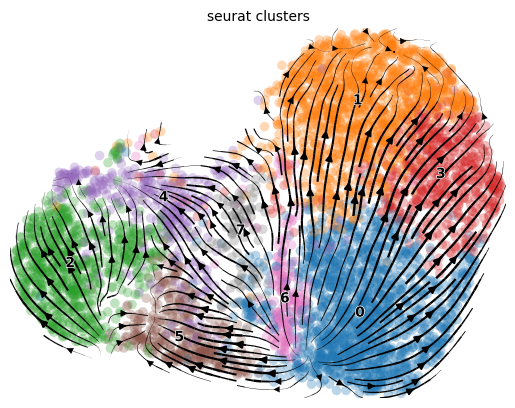

In [40]:
scv.pl.velocity_embedding_stream(cDC1, basis='umap', color = "Stage")
scv.pl.velocity_embedding_stream(cDC1, basis='umap', color = "seurat_clusters")

In [41]:
sc.tl.diffmap(cDC1)
cDC1.obsm["X_diffmap_2D"] = cDC1.obsm["X_diffmap"][:,1:]

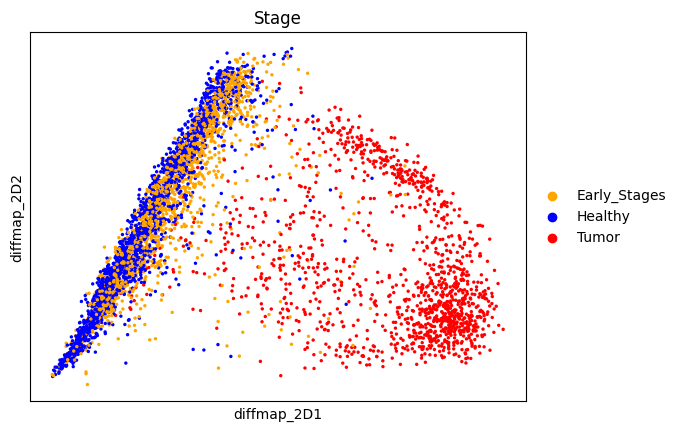

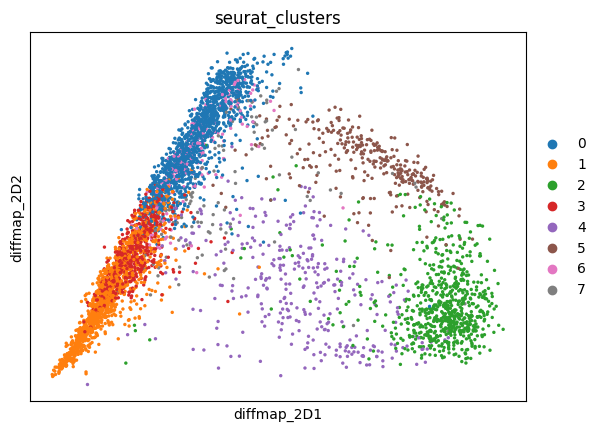

In [42]:
sc.pl.embedding(cDC1, color = 'Stage', basis = "diffmap_2D")
sc.pl.embedding(cDC1, color = 'seurat_clusters', basis = "diffmap_2D")

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

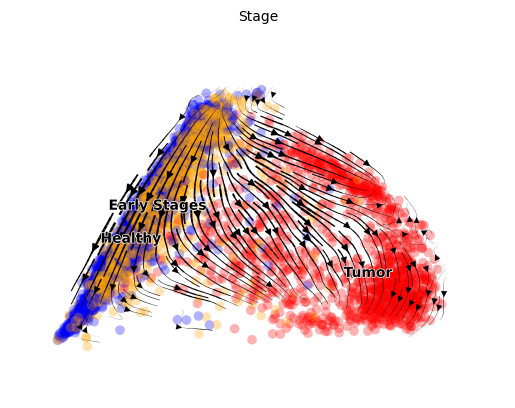

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

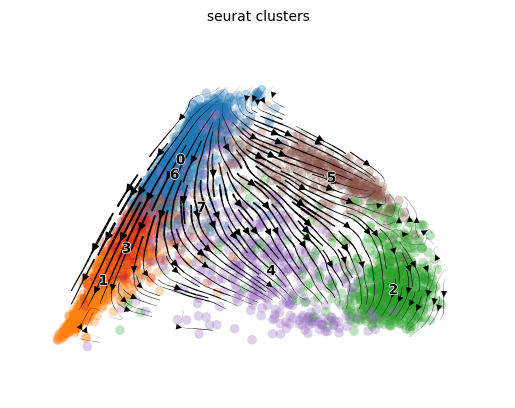

In [43]:
scv.pl.velocity_embedding_stream(cDC1, basis='diffmap', color = "Stage")
scv.pl.velocity_embedding_stream(cDC1, basis='diffmap', color = "seurat_clusters")

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

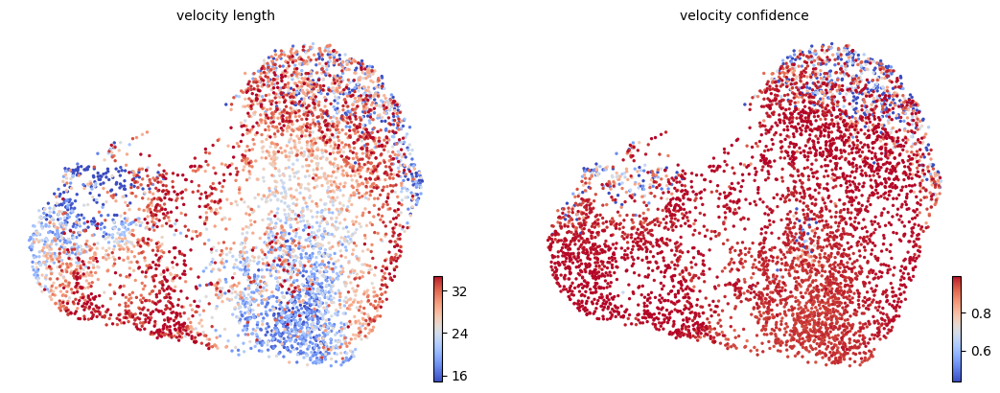

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

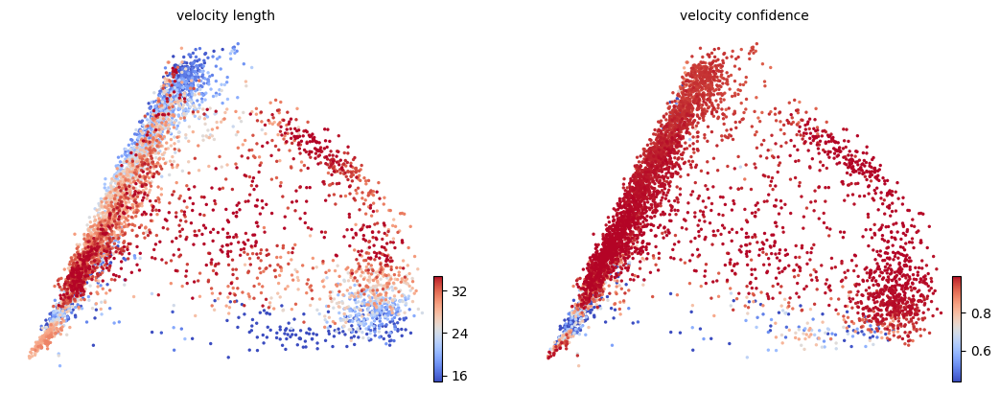

In [44]:
scv.tl.velocity_confidence(cDC1)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(cDC1, c=keys, cmap='coolwarm', perc=[5, 95])
scv.pl.scatter(cDC1, c=keys, cmap='coolwarm', perc=[5, 95], basis = "diffmap")

# Rank velocity genes by Stage

## Color by stage

ranking velocity genes


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/tools/utils.py:463: DeprecationWarning: Please import `rankdata` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.stats.stats import rankdata


    finished (0:00:05) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

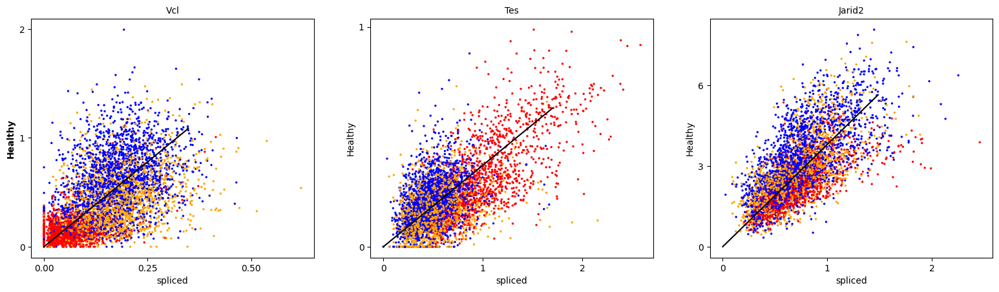

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

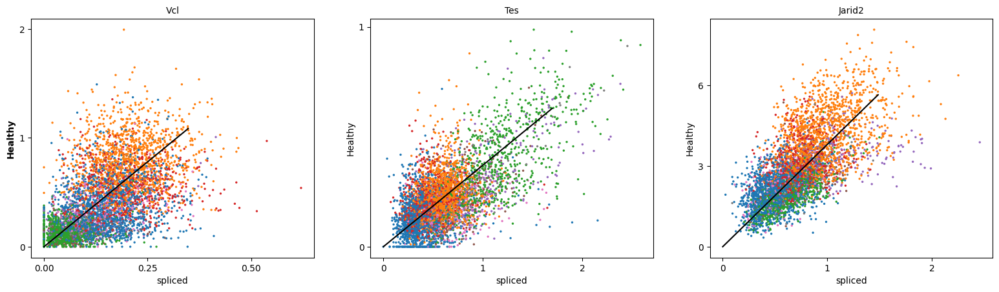

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

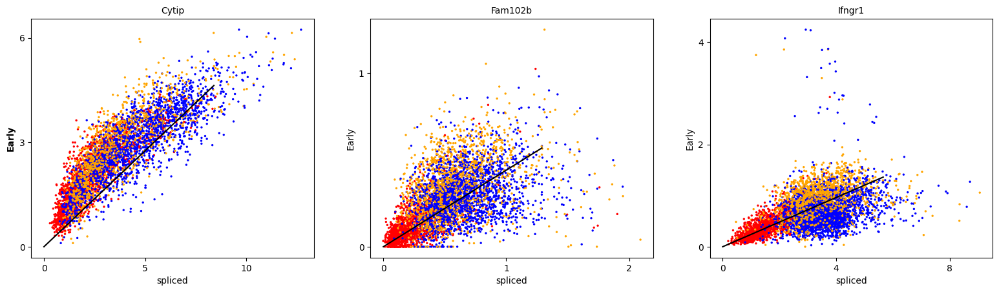

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

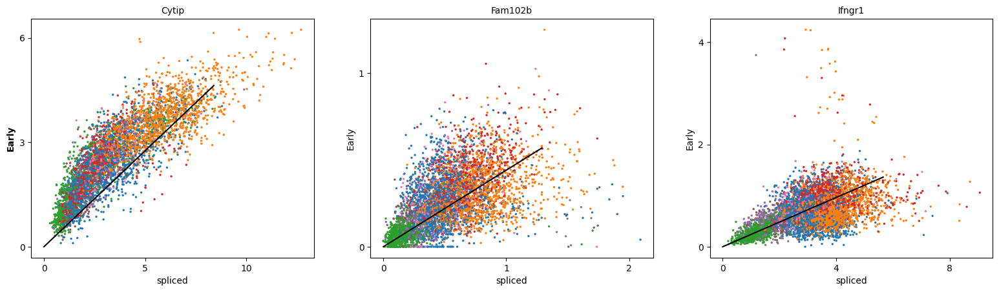

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

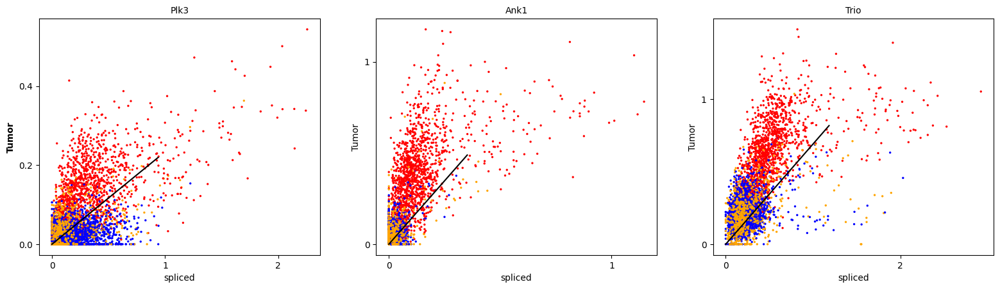

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

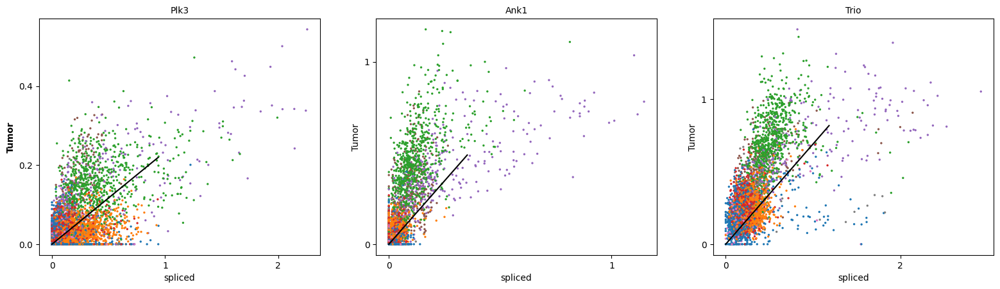

In [176]:
scv.tl.rank_velocity_genes(cDC1, groupby='Stage', min_corr=.3)

df = pd.DataFrame(cDC1.uns['rank_velocity_genes']['names'])
df.head()

scv.pl.scatter(cDC1, df.head(3)["Healthy"].values, color = 'Stage', ylabel = 'Healthy', ncols=3, linewidth=1.5)
scv.pl.scatter(cDC1, df.head(3)["Healthy"].values, color = 'seurat_clusters', ylabel = 'Healthy', ncols=3, linewidth=1.5)

scv.pl.scatter(cDC1, df.head(3)["Early_Stages"].values, color = 'Stage', ylabel = "Early", ncols=3, linewidth=1.5)
scv.pl.scatter(cDC1, df.head(3)["Early_Stages"].values, color = 'seurat_clusters', ylabel = "Early", ncols=3, linewidth=1.5)

scv.pl.scatter(cDC1, df.head(3)["Tumor"].values, color = 'Stage', ylabel = "Tumor", ncols=3, linewidth=1.5)
scv.pl.scatter(cDC1, df.head(3)["Tumor"].values, color = 'seurat_clusters', ylabel = "Tumor", ncols=3, linewidth=1.5)

In [184]:
cDC1.uns["rank_velocity_genes"]


{'names': rec.array([('Cytip', 'Vcl', 'Plk3'), ('Fam102b', 'Tes', 'Ank1'),
            ('Ifngr1', 'Jarid2', 'Trio'), ('Slfn1', 'Basp1', 'Cdc14a'),
            ('Peli1', 'Vav3', 'Lrba'), ('Ptpro', 'Slfn1', 'AU020206'),
            ('Timeless', 'Atp2b1', 'Smim3'), ('Phf11c', 'Nudt9', 'Grasp'),
            ('Mndal', 'Arhgap26', 'Abi3'), ('Skint3', 'Vim', 'Stat2'),
            ('Dnase1l3', 'Anxa2', 'Mbnl1'), ('Hspa5', 'Cpne4', 'Gpr33'),
            ('Spint1', 'Alcam', 'Lrch3'), ('Atf3', 'Ptprc', 'Hsp90aa1'),
            ('Ccr2', 'Timd4', 'Lpcat2'), ('Vim', 'Lrrc8c', 'Clec2d'),
            ('Svbp', 'Ubash3b', 'Parp9'), ('Rgs1', 'Kdm7a', 'Parp14'),
            ('Ifitm2', 'Spint1', 'Znfx1'), ('Map3k1', 'Ahnak', 'Trim30a'),
            ('Slfn5', 'Iqgap2', 'Dcstamp'), ('Qpct', 'Phactr2', 'Atf3'),
            ('Cpne2', 'Cpne2', 'Adam23'), ('Ildr1', 'Slc15a2', 'Adap2'),
            ('Atp2b1', 'Hmgcs1', 'Cd274'), ('Slc15a2', 'Mndal', 'Pip4k2a'),
            ('Irf7', 'Pdia6', 'Itgax'), ('Baz1a', 'T

Healthy

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

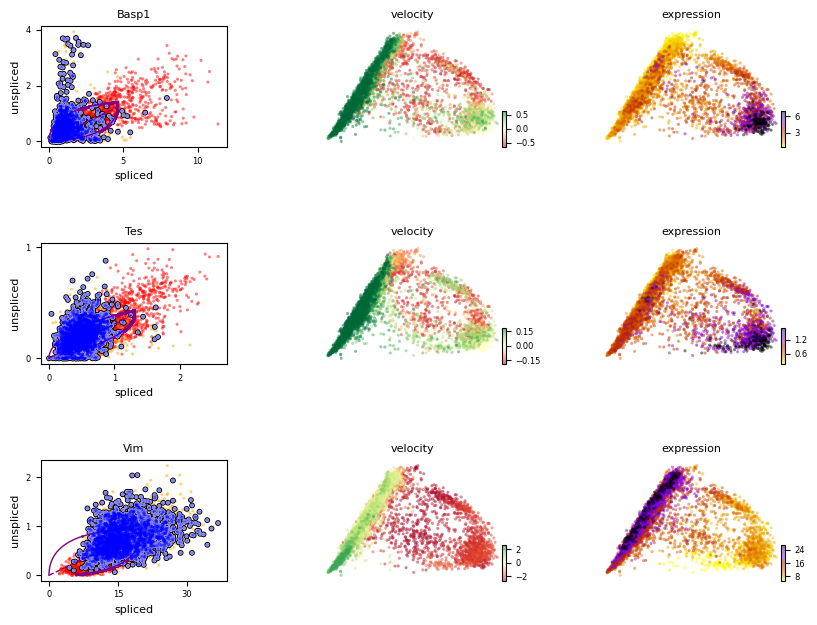

In [46]:
scv.pl.velocity(cDC1, df.head(3)["Healthy"].values, ncols=1, add_outline="Healthy", size = 20, basis="diffmap", color = "Stage")

Early

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

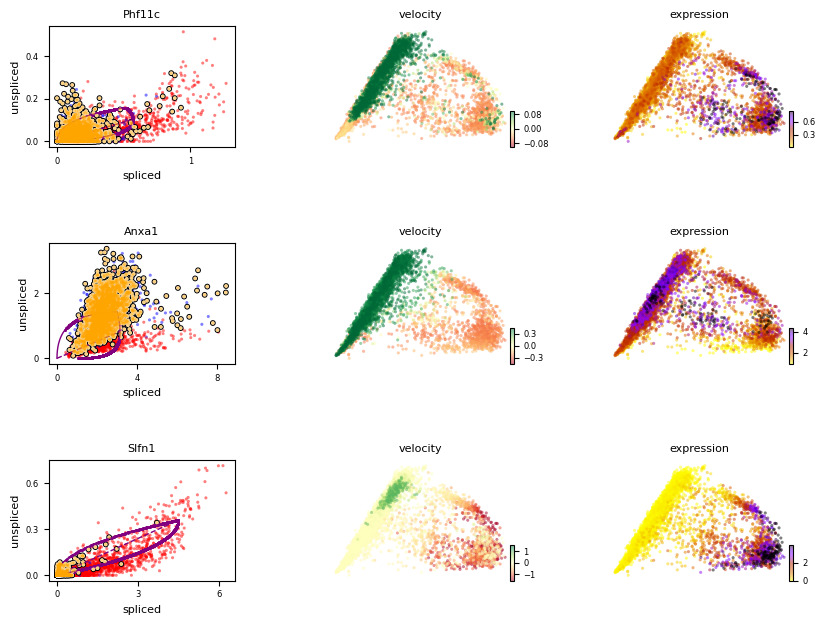

In [47]:
scv.pl.velocity(cDC1, df.head(3)["Early_Stages"].values, ncols=1, add_outline="Early_Stages", size = 20, basis="diffmap", color = "Stage")

Tumor

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

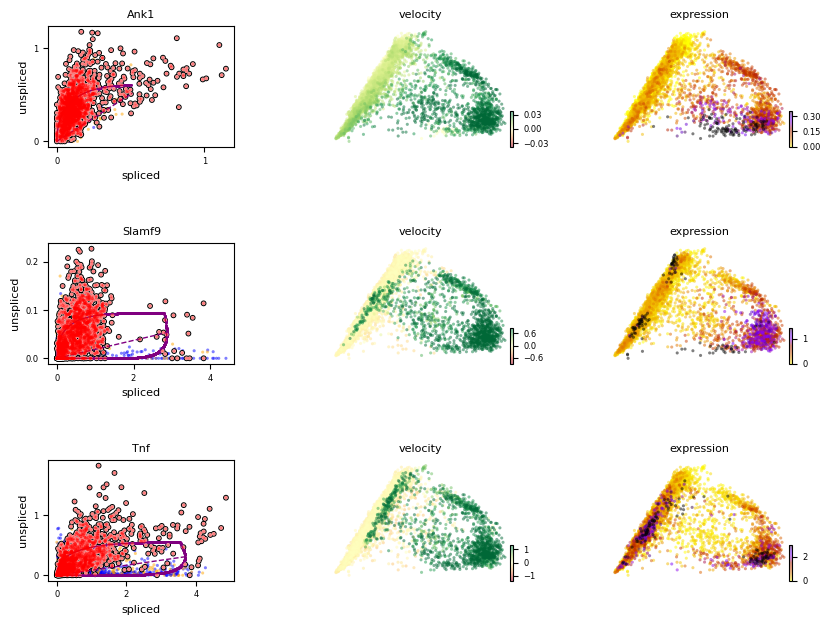

In [48]:
scv.pl.velocity(cDC1, df.head(3)["Tumor"].values, ncols=1, add_outline="Tumor", size = 20, basis="diffmap", color = "Stage")

# Rank velocity genes by cluster

In [185]:
df

,Early_Stages,Healthy,Tumor
0,Cytip,Vcl,Plk3
1,Fam102b,Tes,Ank1
2,Ifngr1,Jarid2,Trio
3,Slfn1,Basp1,Cdc14a
4,Peli1,Vav3,Lrba
...,...,...,...
95,Cpne4,Trim30d,Trim30d
96,Havcr2,Capn3,Fam129a
97,Bhlhe40,Usp18,Capn3
98,Dapk1,Ifi44l,Bcar3


ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

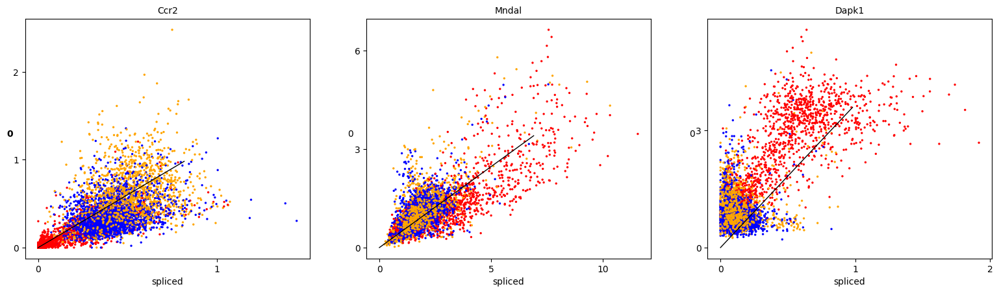

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

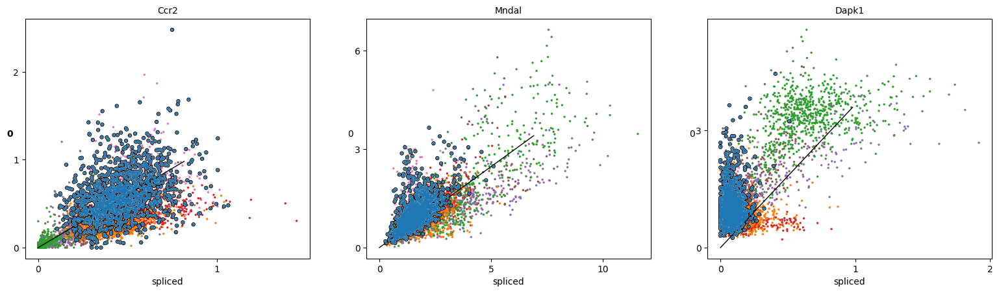

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

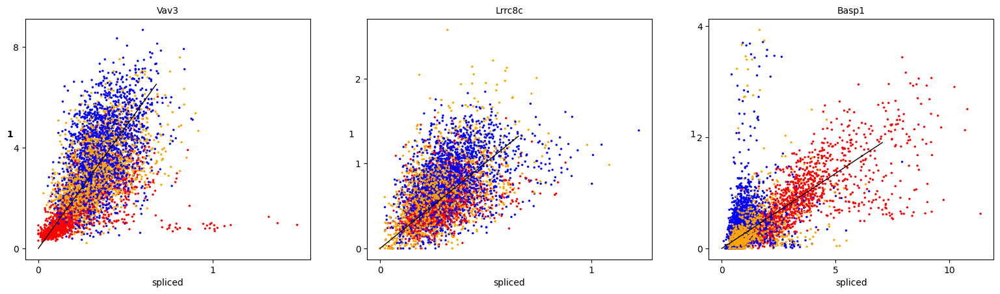

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

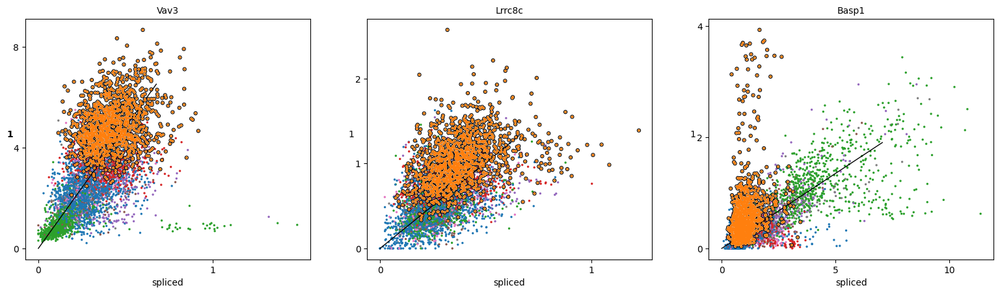

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

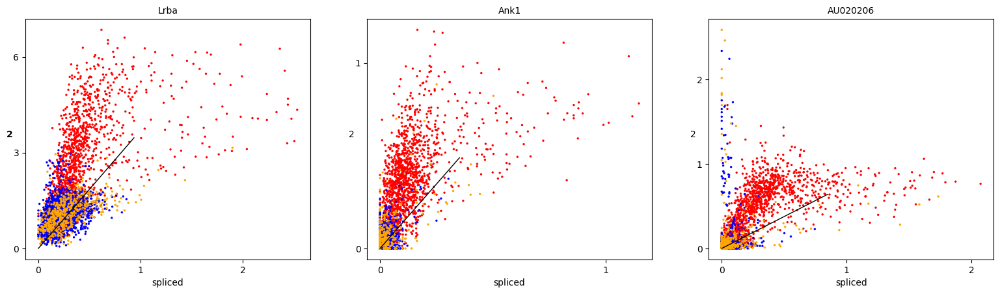

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

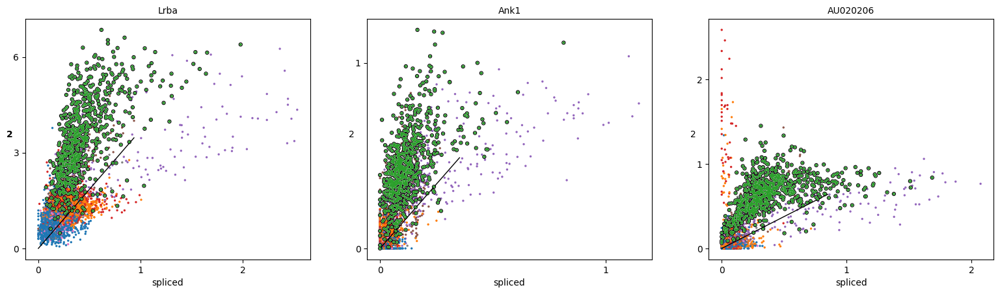

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

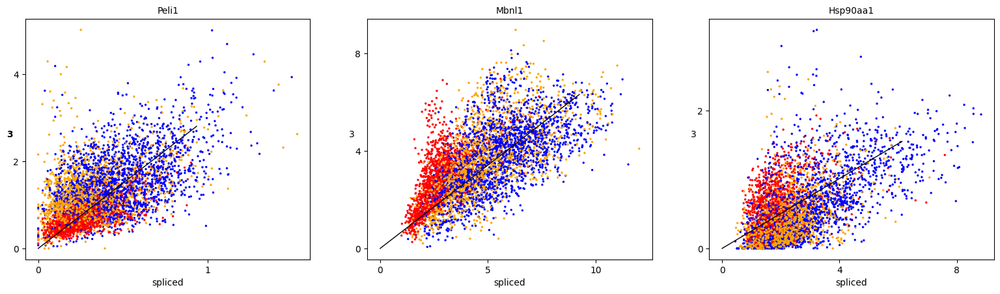

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

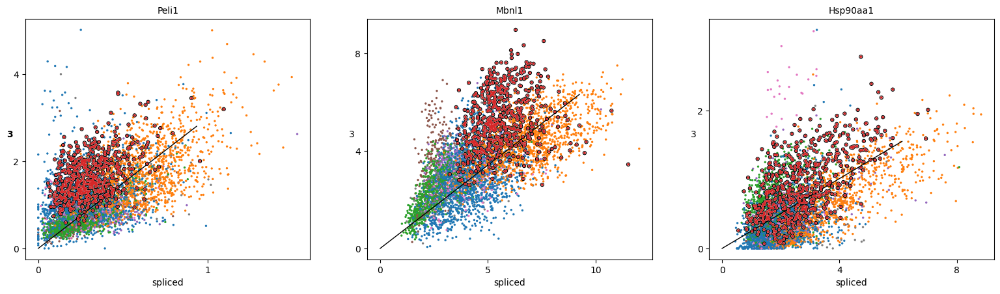

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

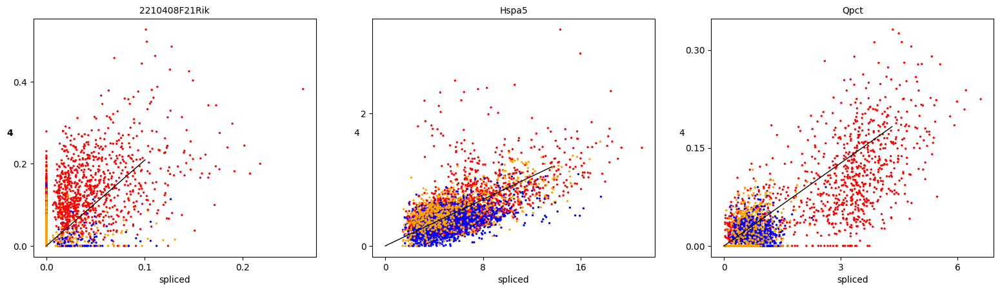

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

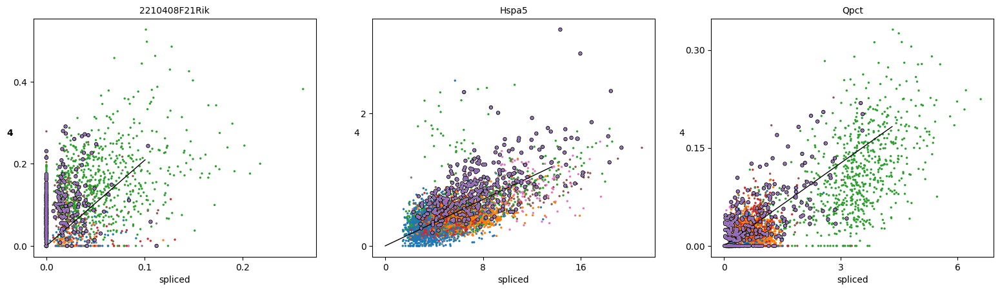

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

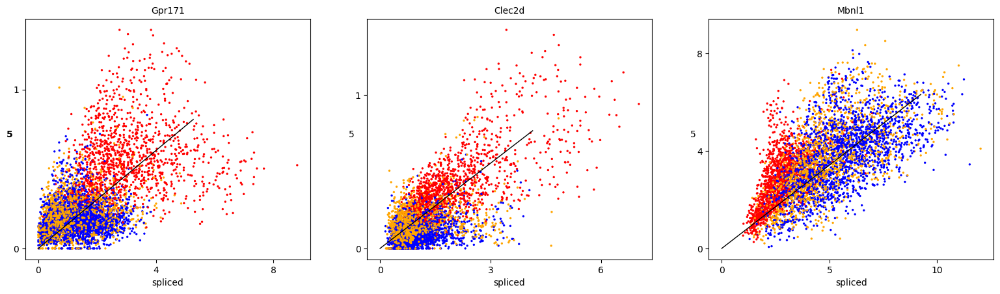

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

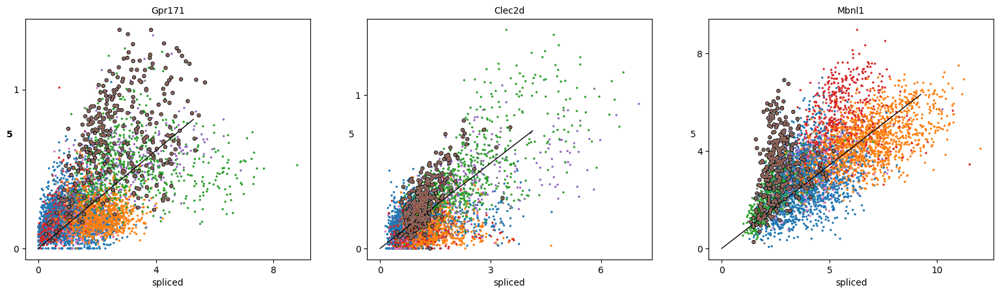

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

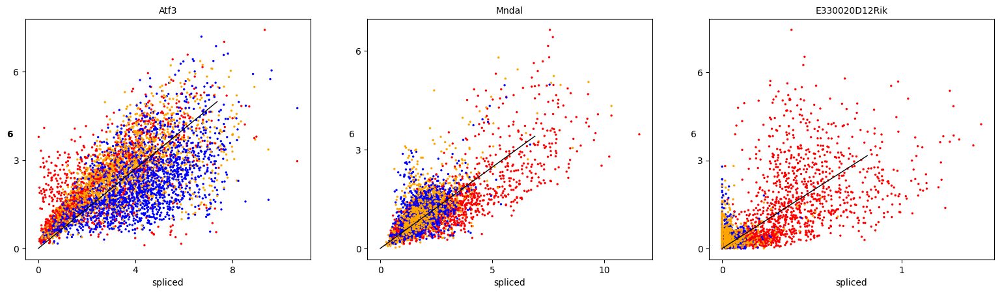

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

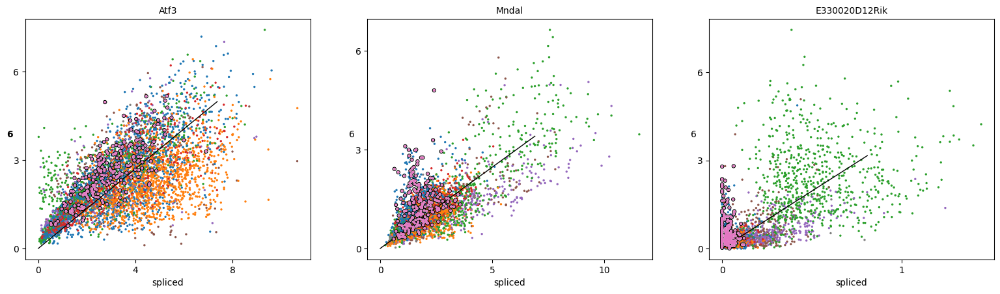

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

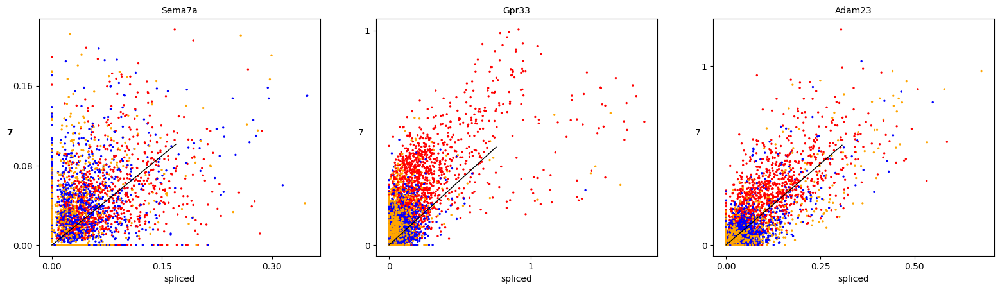

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

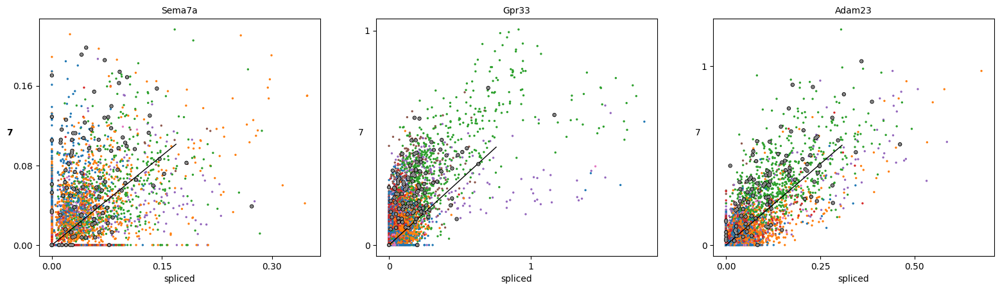

In [186]:
scv.tl.rank_velocity_genes(cDC1, groupby='seurat_clusters', min_corr=.3)

df = pd.DataFrame(cDC1.uns['rank_velocity_genes']['names'])
df.head()

scv.pl.scatter(cDC1, df.head(3)["0"].values, color = 'Stage', ylabel = '0', ncols=3, add_outline="0")
scv.pl.scatter(cDC1, df.head(3)["0"].values, color = 'seurat_clusters', ylabel = '0', ncols=3, add_outline="0")

scv.pl.scatter(cDC1, df.head(3)["1"].values, color = 'Stage', ylabel = "1", ncols=3, add_outline="1")
scv.pl.scatter(cDC1, df.head(3)["1"].values, color = 'seurat_clusters', ylabel = "1", ncols=3, add_outline="1")

scv.pl.scatter(cDC1, df.head(3)["2"].values, color = 'Stage', ylabel = "2", ncols=3, add_outline="2")
scv.pl.scatter(cDC1, df.head(3)["2"].values, color = 'seurat_clusters', ylabel = "2", ncols=3, add_outline="2")

scv.pl.scatter(cDC1, df.head(3)["3"].values, color = 'Stage', ylabel = "3", ncols=3, add_outline="3")
scv.pl.scatter(cDC1, df.head(3)["3"].values, color = 'seurat_clusters', ylabel = "3", ncols=3, add_outline="3")

scv.pl.scatter(cDC1, df.head(3)["4"].values, color = 'Stage', ylabel = "4", ncols=3, add_outline="4")
scv.pl.scatter(cDC1, df.head(3)["4"].values, color = 'seurat_clusters', ylabel = "4", ncols=3, add_outline="4")

scv.pl.scatter(cDC1, df.head(3)["5"].values, color = 'Stage', ylabel = "5", ncols=3, add_outline="5")
scv.pl.scatter(cDC1, df.head(3)["5"].values, color = 'seurat_clusters', ylabel = "5", ncols=3, add_outline="5")

scv.pl.scatter(cDC1, df.head(3)["6"].values, color = 'Stage', ylabel = "6", ncols=3, add_outline="6")
scv.pl.scatter(cDC1, df.head(3)["6"].values, color = 'seurat_clusters', ylabel = "6", ncols=3, add_outline="6")

scv.pl.scatter(cDC1, df.head(3)["7"].values, color = 'Stage', ylabel = "7", ncols=3, add_outline="7")
scv.pl.scatter(cDC1, df.head(3)["7"].values, color = 'seurat_clusters', ylabel = "7", ncols=3, add_outline="7")




/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

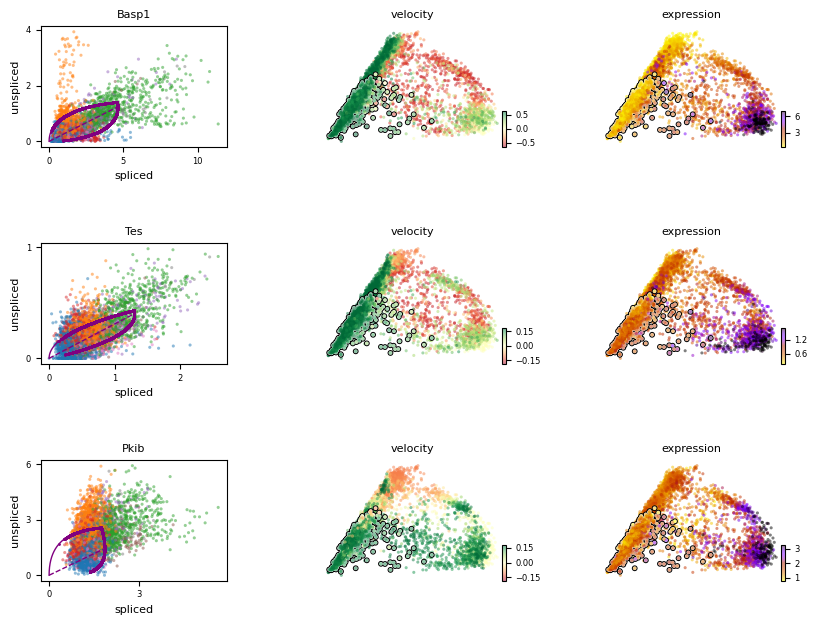

In [50]:
scv.pl.velocity(cDC1, df.head(3)["1"].values, ncols=1, add_outline="1", size = 20, basis="diffmap", color = "seurat_clusters")

In [187]:
df

,0,1,2,3,4,5,6,7
0,Ccr2,Vav3,Lrba,Peli1,2210408F21Rik,Gpr171,Atf3,Sema7a
1,Mndal,Lrrc8c,Ank1,Mbnl1,Hspa5,Clec2d,Mndal,Gpr33
2,Dapk1,Basp1,AU020206,Hsp90aa1,Qpct,Mbnl1,E330020D12Rik,Adam23
3,Skint3,Timd4,Trio,Pip4k2a,Mbnl1,Gpr33,Phf11c,Iigp1
4,Slfn1,Cpne4,Stat2,Phactr2,Itgax,Grasp,Ptpro,Serpinb9
...,...,...,...,...,...,...,...,...
95,Grasp,Kctd14,Zbp1,AU020206,Cd226,Herpud1,Plk3,Bcar3
96,Capn3,Qpct,Kit,Hspa5,Havcr2,Fam129a,Irf7,Card11
97,Pip4k2a,Il21r,Chic1,Ctla2b,Ptpro,H2-T22,Il12b,Trio
98,Ifi204,Ccnd2,Hmgcs1,Nr4a3,Anks3,Cd226,Adap2,Hsp90b1


# Cytopath

In [51]:
import cytopath

In [52]:
scv.tl.terminal_states(cDC1, random_state=123)
cDC1.uns["T_forward"] = scv.utils.get_transition_matrix(cDC1, self_transitions=False)
scv.tl.velocity_embedding(cDC1)

computing terminal states
    identified 3 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

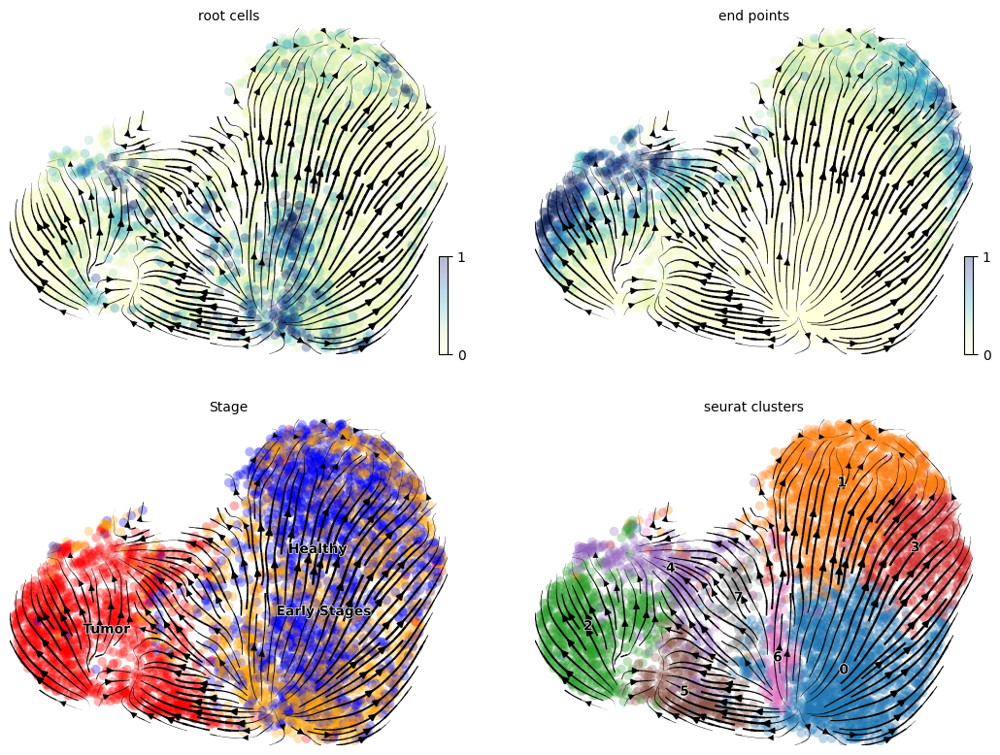

In [53]:
scv.pl.velocity_embedding_stream(cDC1, color=['root_cells', 'end_points',
                                               'Stage', "seurat_clusters"],
                                             ncols=2, color_map='YlGnBu')

/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/Users/mscavino/miniconda3/envs/scvelo/lib/python

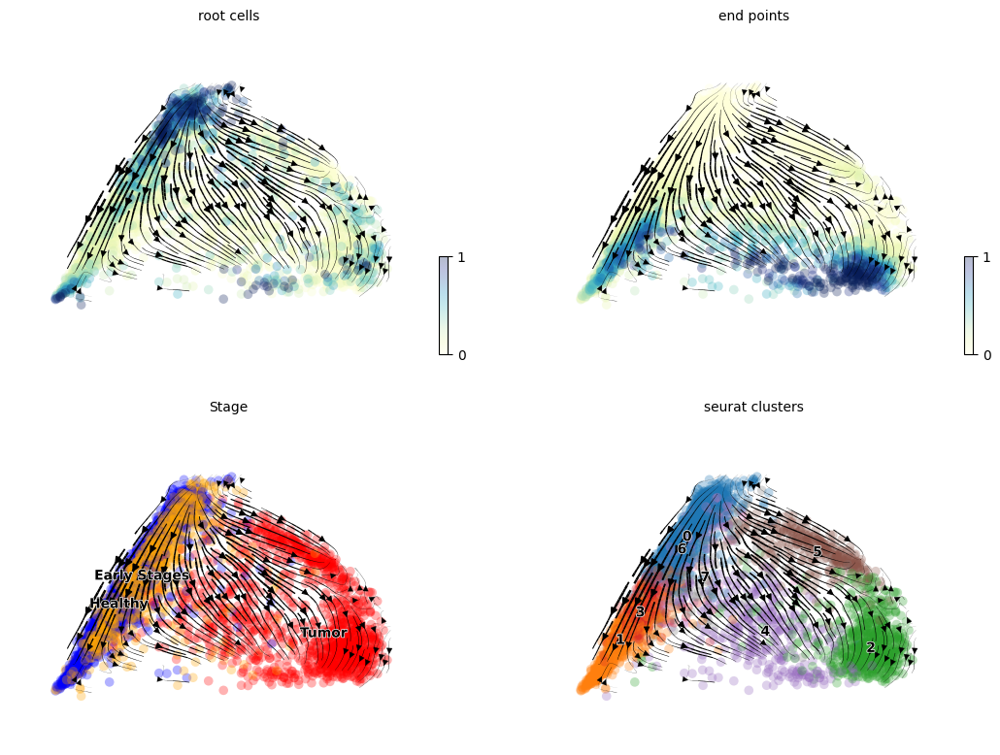

In [54]:
scv.pl.velocity_embedding_stream(cDC1, color=['root_cells', 'end_points',
                                               'Stage', "seurat_clusters"],
                                             ncols=2, color_map='YlGnBu', basis="diffmap")

In [55]:
import os

cDC1.obs["seurat_clusters"] = [str(i) for i in tab["seurat_clusters"].values]
cDC1.obs["seurat_clusters"] = pd.Categorical(cDC1.obs["seurat_clusters"])

cytopath.sampling(cDC1, cluster_key="seurat_clusters", num_cores=os.cpu_count()-1, max_iter = 800, max_steps=100)
#infer trajectories

Adjusting simulation parameters based on dataset properties. Set auto_adjust=False if this is unwanted.
Number of required simulations per end point (traj_number) set to 740
Number of initial simulations (sim_number) set to 14875


Iterating state probability distributions: 100%|██████████| 800/800 [00:02<00:00, 379.33it/s]


Tolerance reached after 23 iterations of 800.
Number of initial simulation steps (max_steps) set to 23

Sampling round: 0


100%|██████████| 103/103 [00:12<00:00,  8.38it/s]


Sampling done.


In [56]:
cytopath.trajectories(cDC1, num_cores=os.cpu_count()-1, basis = "diffmap_2D")

Calculating hausdorff distances


100%|██████████| 740/740 [00:09<00:00, 81.08it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:03<00:00,  1.64s/it]


Sample clustering done. Aligning clusters for end point 2
Calculating hausdorff distances


100%|██████████| 740/740 [00:08<00:00, 84.90it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:03<00:00,  1.69s/it]


Sample clustering done. Aligning clusters for end point 3
Calculating hausdorff distances


100%|██████████| 740/740 [00:08<00:00, 84.28it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:03<00:00,  1.59s/it]


Sample clustering done. Aligning clusters for end point 4
Computing neighborhoods of trajectories for end point 2 at each step


100%|██████████| 1/1 [00:00<00:00,  2.60it/s]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  2


100%|██████████| 104/104 [00:09<00:00, 11.41it/s]


Removing cells below cutoff threshold from trajectories for end point  2 (i.e. cells neighborhood)


100%|██████████| 1/1 [00:00<00:00, 151.08it/s]


Computing neighborhoods of trajectories for end point 3 at each step


100%|██████████| 1/1 [00:00<00:00,  1.99it/s]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  3


100%|██████████| 112/112 [00:09<00:00, 12.19it/s]


Removing cells below cutoff threshold from trajectories for end point  3 (i.e. cells neighborhood)


100%|██████████| 1/1 [00:00<00:00, 67.75it/s]


Computing neighborhoods of trajectories for end point 4 at each step


100%|██████████| 1/1 [00:00<00:00,  2.50it/s]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  4


100%|██████████| 106/106 [00:07<00:00, 13.55it/s]


Removing cells below cutoff threshold from trajectories for end point  4 (i.e. cells neighborhood)


100%|██████████| 1/1 [00:00<00:00, 135.50it/s]


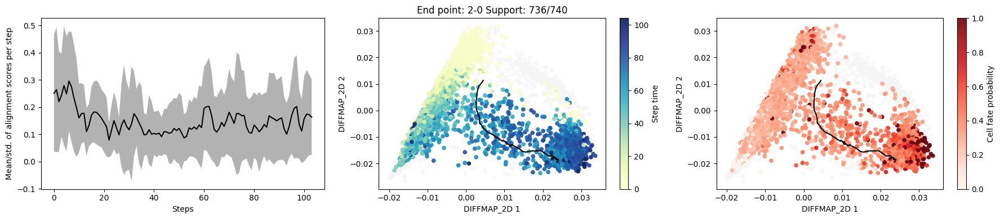

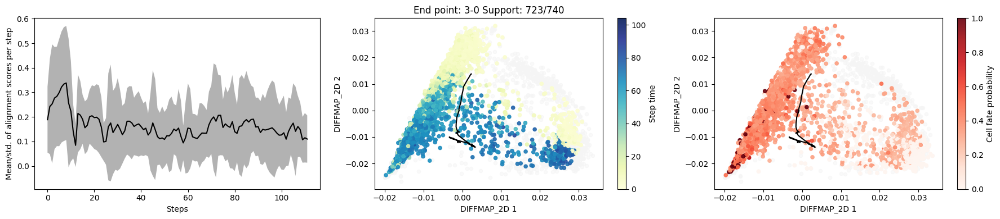

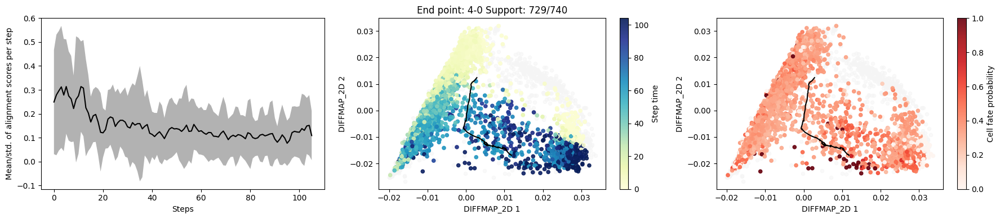

In [57]:
# Plot allignment and trajectories
cytopath.plot_trajectories(cDC1, directory='', basis='diffmap_2D', smoothing=False, size=20, figsize=(18,4))

In [58]:
cytopath.trajectories(cDC1, num_cores=os.cpu_count()-1)

Calculating hausdorff distances


100%|██████████| 740/740 [00:08<00:00, 85.58it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:04<00:00,  2.12s/it]


Sample clustering done. Aligning clusters for end point 2
Calculating hausdorff distances


100%|██████████| 740/740 [00:08<00:00, 86.02it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:04<00:00,  2.18s/it]


Sample clustering done. Aligning clusters for end point 3
Calculating hausdorff distances


100%|██████████| 740/740 [00:08<00:00, 85.34it/s] 


Clustering using hausdorff distances
Forming trajectory by aligning clusters


100%|██████████| 2/2 [00:04<00:00,  2.17s/it]


Sample clustering done. Aligning clusters for end point 4
Computing neighborhoods of trajectories for end point 2 at each step


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  2


100%|██████████| 331/331 [00:27<00:00, 11.96it/s]


Removing cells below cutoff threshold from trajectories for end point  2 (i.e. cells neighborhood)


100%|██████████| 1/1 [00:00<00:00, 50.21it/s]


Computing neighborhoods of trajectories for end point 3 at each step


100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  3


100%|██████████| 303/303 [00:27<00:00, 11.01it/s]


Removing cells below cutoff threshold from trajectories for end point  3 (i.e. cells neighborhood)


100%|██████████| 1/1 [00:00<00:00, 64.30it/s]


Computing neighborhoods of trajectories for end point 4 at each step


100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


Computing alignment score of cells in trajectory neighborhood w.r.t. trajectories for end point  4


100%|██████████| 353/353 [00:37<00:00,  9.48it/s]


Removing cells below cutoff threshold from trajectories for end point  4 (i.e. cells neighborhood)


100%|██████████| 1/1 [00:00<00:00, 50.90it/s]


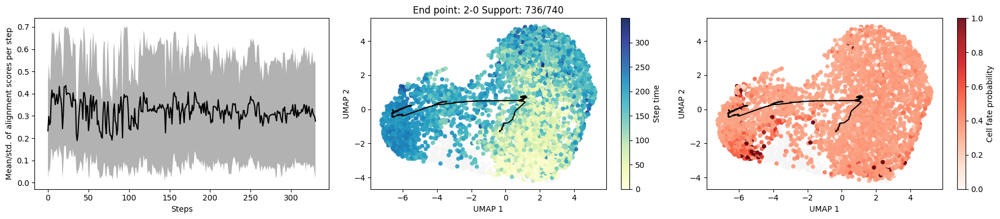

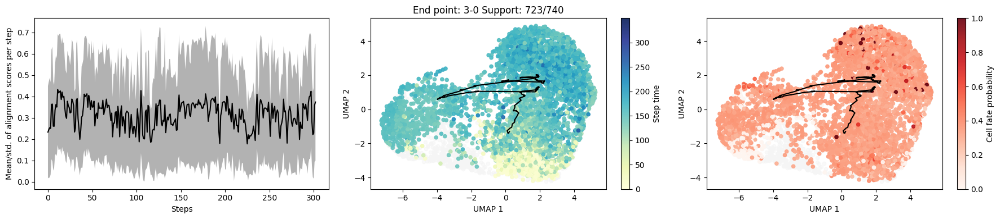

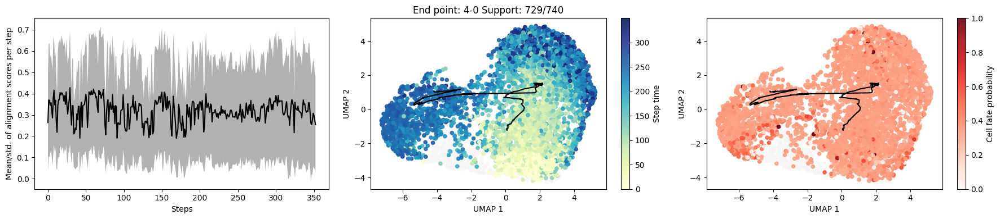

In [59]:
cytopath.plot_trajectories(cDC1, directory='', basis='umap', smoothing=False, size=20, figsize=(18,4))

Le cluster 0 et à priori le 6 aussi semble plutôt être associé à un stade précoce des DC, peut être que les DC activés sont plutôt à chercher dans le cluster 1 même si moins infiltré en prénéo.